<a href="https://colab.research.google.com/github/eabz66/ChicagoCrime/blob/main/ChicagoCrimeV3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Chicago Crime Data Analysis**
### Author: Eduardo Bistrain (2023)



---


This notebook provides a way to analyze crime data made available by the City of Chicago.

https://data.cityofchicago.org/Public-Safety/Crimes-2001-to-Present/ijzp-q8t2

In this tutorial you will learn how to:
- Use MapQuest API to find the Latitude/Longitude coordinates for an address (and viceversa).
- Use GeoPandas to plot maps from open-sourced shape files.
- Load dataframe to an in-memory database, and use SQL queries to filter/summarize crime data.
- Generate different plots and crosstabs for a particular address.
- Do crime comparison between two addresses.


# Install and load libraries

In [ ]:
# Attach google drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Read MapQuest API key
with open('drive/MyDrive/API_Keys/mapquest_key.txt') as f:
  lines = f.readlines()
#The key is the first element of the list
mapquest_api_key = lines[0]

In [ ]:
!pip install ipywidgets

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 19.0 MB/s eta 0:00:00


In [ ]:
!pip install geopandas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 13.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.4/16.4 MB 60.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.7/7.7 MB 69.4 MB/s eta 0:00:00


In [ ]:
import pandas as pd
import sqlite3
import pandas as pd
import numpy as np
import seaborn as sns
from matplotlib import pyplot as plt
%matplotlib inline

import geopandas as gpd
from shapely.geometry import Point, Polygon

# Common Functions

In [ ]:
# Assembling the query to filter results
def resultsInsideCoordinates(Min_Lat, Max_Lat, Min_Lon, Max_Lon, numDays):
  query = \
  f"SELECT * \
  FROM ChicagoCrime \
  WHERE date >= date()-{numDays} \
  AND latitude >= {Min_Lat} AND latitude <= {Max_Lat} \
  AND longitude >= {Min_Lon} AND longitude <= {Max_Lon} \
  ORDER BY date \
  ;"
  #print(query)
  tmpDF = pd.read_sql_query(query, conn)
  return(tmpDF)

def countByColsAndCoordinates(col1, col2, Min_Lat, Max_Lat, Min_Lon, Max_Lon, numDays):
  query = \
  f"SELECT {col1}, {col2}, COUNT(*) AS cnt \
  FROM ChicagoCrime \
  WHERE date >= date()-{numDays} \
  AND latitude >= {Min_Lat} AND latitude <= {Max_Lat} \
  AND longitude >= {Min_Lon} AND longitude <= {Max_Lon} \
  GROUP BY {col1}, {col2} \
  ORDER BY cnt DESC \
  ;"
  #print(query)
  tmpDF = pd.read_sql_query(query, conn)
  return(tmpDF)

In [ ]:
import requests
import json

# Function used to find the Latitude/Longitude coordinates of address provided using MapQuest API
def find_address_ccordinates(streetAddr):
  parameters = {
      "key" : mapquest_api_key,
      "location" : streetAddr
      }
  response = requests.get("https://www.mapquestapi.com/geocoding/v1/address", params=parameters)
  data = json.loads(response.text)['results']

  lat = data[0]['locations'][0]['latLng']['lat']
  lon = data[0]['locations'][0]['latLng']['lng']
  return(lat, lon)

In [ ]:
# Function used to find the address corresponding to the Latitude/Longitude provided using MapQuest API
def find_address_from_ccordinates(latitude, longitude):
  locString = "%0.5f, %0.5f" % (latitude, longitude)
  parameters = {
      "key" : mapquest_api_key,
      "location" : locString
      }
  response = requests.get("https://www.mapquestapi.com/geocoding/v1/reverse", params=parameters)
  print(response)
  data = json.loads(response.text)['results']
  x = data[0]['locations'][0]
  addressString = "%s %s %s %s %s %s %s %s" % (x['street'], x['adminArea6'], x['postalCode'], x['adminArea5'], 
                                               x['adminArea4'], x['adminArea4Type'], x['adminArea3'], x['adminArea1'])
  return(addressString)

In [ ]:
# Function that lets you generate scatterplots of two columns in dataframe (xVar and yVar)
# by specific values of the catVar column. You can optionally color points.
def scatterplotXYByCategory(df, xVar, yVar, catVar, color=None, addPoint=None):
  # Get unique values of categorical variable
  catValues = df[catVar].unique()
  sns.set(rc={'figure.figsize':(9,9)})
  for aVal in catValues:
    # Filter dataframe using specific value in categorical variable
    tmpDF = df[ df[catVar] == aVal]
    # Generate scatterplot for this dataframe
    if color != None:
      sns.scatterplot(x=xVar, y=yVar, hue=color, palette='RdBu_r',
                    hue_order=np.sort(df[color].unique()), 
                    alpha=0.6, data=tmpDF).set(title="%s: %s   [%d instances]" % (catVar, aVal, tmpDF.shape[0]))
    else:
      sns.scatterplot(x=xVar, y=yVar,
                    alpha=0.6, data=tmpDF).set(title="%s: %s   [%d instances]" % (catVar, aVal, tmpDF.shape[0]))
    if addPoint != None:
      lat, lon = addPoint
      plt.scatter(x=lon, y=lat, color='black', s=100, marker='*') # Include location with most crime
    plt.show()

In [ ]:
# MAPPING FUNCTIONS

# Converts (lat, long) coordinates into points that can be plotted in map
# Accepts a dataframe with 'latitude' and 'longitude' columns.
def createGeoDataFrame(pointDF):
  # Create ge-points
  geometry = [Point(xy) for xy in zip(pointDF["longitude"], pointDF["latitude"])]

  # Create geo-dataframe with points
  geodata = gpd.GeoDataFrame(pointDF, crs={'init':'epsg:4326'}, geometry=geometry)
  return geodata


# Shows an area of a map bounded by the minLat, maxLat, minLong, maxLong coordinates.
# Optionally, you can show some points in the map.
def showMapAreaAndPoints(aMapDF, minLat, maxLat, minLong, maxLong, points_df=None, mainPoint_df=None):
  # Set image properties
  fig, ax = plt.subplots(1, figsize=(12,12))

  # Set coordinates to area (rectangle) you want to show in map
  margin = 0.001
  ax.set_xlim(minLong-margin, maxLong+margin)
  ax.set_ylim(minLat-margin, maxLat+margin)
  ax.set_aspect('equal')
  ax.axis('off')

  # Define map properties
  map_df.plot(ax=ax, alpha=1, linewidth=1, edgecolor='xkcd:dark green blue', cmap="Wistia")
  if points_df is not None:
    # Define points in map
    points_df.plot(ax=ax, color='red', marker='+', markersize=15);
  if mainPoint_df is not None:
    # Define point in map
    mainPoint_df.plot(ax=ax, color='black', marker='*', markersize=30);
  # Plot map
  plt.show()

# Loading Data

IL Map data

In [ ]:
# Import shapefile including all roads in IL
# Downloaded shapefile from:
# https://mapcruzin.com/free-united-states-shapefiles/free-illinois-arcgis-maps-shapefiles.htm
map_df = gpd.read_file('drive/MyDrive/Maps/illinois_highway/illinois_highway.shp')

In [ ]:
map_df.head()

,TYPE,NAME,ONEWAY,geometry
0,service,NaN,NaN,"LINESTRING (-91.50658 38.93602, -91.50632 38.9..."
1,residential,NaN,NaN,"LINESTRING (-91.50349 38.25430, -91.50361 38.2..."
2,residential,Miller Dr,NaN,"LINESTRING (-91.50629 38.28090, -91.50585 38.2..."
3,residential,Bader Rd,NaN,"LINESTRING (-91.50643 38.77553, -91.50631 38.7..."
4,residential,Hummingbird Ln,NaN,"LINESTRING (-91.47956 39.33467, -91.48042 39.3..."


Crime Data

In [ ]:
# Load dataset directly from source (in JSON format)
# Getting roughly 3 months worth of data ~ 60K records
df = pd.read_json("https://data.cityofchicago.org/resource/crimes.json?$limit=60000")
print(df.shape)
df.head()

(60000, 30)


,id,case_number,date,block,iucr,primary_type,description,location_description,arrest,domestic,...,longitude,location,:@computed_region_awaf_s7ux,:@computed_region_6mkv_f3dw,:@computed_region_vrxf_vc4k,:@computed_region_bdys_3d7i,:@computed_region_43wa_7qmu,:@computed_region_rpca_8um6,:@computed_region_d9mm_jgwp,:@computed_region_d3ds_rm58
0,13084327,JG273985,2023-05-24 23:58:00,068XX S WOOD ST,0820,THEFT,$500 AND UNDER,RESIDENCE,False,True,...,-87.668804,"{'latitude': '41.769637538', 'longitude': '-87...",17.0,22257.0,65.0,283.0,31.0,23.0,17.0,204.0
1,13084277,JG274008,2023-05-24 23:45:00,018XX W JACKSON BLVD,0520,ASSAULT,AGGRAVATED - KNIFE / CUTTING INSTRUMENT,APARTMENT,False,True,...,-87.672388,"{'latitude': '41.877532811', 'longitude': '-87...",48.0,21184.0,29.0,90.0,46.0,28.0,15.0,139.0
2,13084339,JG274110,2023-05-24 23:45:00,062XX S MARSHFIELD AVE,0910,MOTOR VEHICLE THEFT,AUTOMOBILE,STREET,False,False,...,-87.665454,"{'latitude': '41.780551382', 'longitude': '-87...",19.0,22257.0,65.0,276.0,2.0,23.0,17.0,164.0
3,13084426,JG274227,2023-05-24 23:45:00,007XX W 87TH ST,0910,MOTOR VEHICLE THEFT,AUTOMOBILE,STREET,False,False,...,-87.642783,"{'latitude': '41.736283491', 'longitude': '-87...",18.0,21554.0,70.0,529.0,13.0,59.0,20.0,236.0
4,13084216,JG273980,2023-05-24 23:43:00,014XX W MONTROSE AVE,0860,THEFT,RETAIL THEFT,CONVENIENCE STORE,False,False,...,-87.666419,"{'latitude': '41.961628063', 'longitude': '-87...",13.0,21186.0,57.0,650.0,18.0,53.0,5.0,8.0


In [ ]:
df.tail()

,id,case_number,date,block,iucr,primary_type,description,location_description,arrest,domestic,...,longitude,location,:@computed_region_awaf_s7ux,:@computed_region_6mkv_f3dw,:@computed_region_vrxf_vc4k,:@computed_region_bdys_3d7i,:@computed_region_43wa_7qmu,:@computed_region_rpca_8um6,:@computed_region_d9mm_jgwp,:@computed_region_d3ds_rm58
59995,12993785,JG165085,2023-02-24 00:55:00,003XX E 116TH ST,0890,THEFT,FROM BUILDING,APARTMENT,False,False,...,-87.615494,"{'latitude': '41.682593729', 'longitude': '-87...",30.0,21861.0,50.0,229.0,43.0,19.0,10.0,219.0
59996,12992064,JG163711,2023-02-24 00:52:00,107XX S AVENUE O,1320,CRIMINAL DAMAGE,TO VEHICLE,ALLEY,False,False,...,-87.540090,"{'latitude': '41.70039991', 'longitude': '-87....",47.0,21202.0,49.0,602.0,47.0,25.0,19.0,247.0
59997,12992096,JG163710,2023-02-24 00:46:00,0000X N JEFFERSON ST,0810,THEFT,OVER $500,STREET,False,False,...,-87.642683,"{'latitude': '41.882539142', 'longitude': '-87...",22.0,4452.0,29.0,784.0,36.0,45.0,22.0,91.0
59998,12992107,JG163714,2023-02-24 00:45:00,001XX N CENTRAL AVE,0486,BATTERY,DOMESTIC BATTERY SIMPLE,APARTMENT,True,True,...,-87.764962,"{'latitude': '41.883209435', 'longitude': '-87...",52.0,22216.0,26.0,674.0,7.0,32.0,25.0,85.0
59999,12993713,JG165889,2023-02-24 00:45:00,010XX E 73RD ST,051A,ASSAULT,AGGRAVATED - HANDGUN,STREET,False,False,...,-87.598787,"{'latitude': '41.762303822', 'longitude': '-87...",32.0,21546.0,67.0,121.0,33.0,61.0,18.0,217.0


In [ ]:
df.dtypes

id                                      int64
case_number                            object
date                           datetime64[ns]
block                                  object
iucr                                   object
primary_type                           object
description                            object
location_description                   object
arrest                                   bool
domestic                                 bool
beat                                    int64
district                                int64
ward                                  float64
community_area                          int64
fbi_code                               object
x_coordinate                          float64
y_coordinate                          float64
year                                    int64
updated_on                             object
latitude                              float64
longitude                             float64
location                          

# Data Cleanup / Pre-processing

In [ ]:
# Add a Day Of the Week (DOW) feature
df['DOW'] = df['date'].dt.dayofweek+1
df["DOW"] = df["DOW"].astype("string")
df["DOW"]

0        3
1        3
2        3
3        3
4        3
        ..
59995    5
59996    5
59997    5
59998    5
59999    5
Name: DOW, Length: 60000, dtype: string

In [ ]:
# Add an Hour feature
df['Hour'] = df['date'].dt.hour
df["Hour"] = df["Hour"].astype("string")
# prepend a zero if hour is a single digit
df['Hour'] = ["0"+x if len(x)==1 else x for x in df["Hour"]]
df["Hour"]

0        23
1        23
2        23
3        23
4        23
         ..
59995    00
59996    00
59997    00
59998    00
59999    00
Name: Hour, Length: 60000, dtype: object

In [ ]:
# Remove time from date field
from datetime import datetime

df['date'] = df['date'].dt.strftime('%Y-%m-%d')
df['date'] = [datetime.strptime(x, '%Y-%m-%d') for x in df['date']] # Convert string to datetime value
df['date']

0       2023-05-24
1       2023-05-24
2       2023-05-24
3       2023-05-24
4       2023-05-24
           ...    
59995   2023-02-24
59996   2023-02-24
59997   2023-02-24
59998   2023-02-24
59999   2023-02-24
Name: date, Length: 60000, dtype: datetime64[ns]

In [ ]:
# Columns available and data types
df.dtypes

id                                      int64
case_number                            object
date                           datetime64[ns]
block                                  object
iucr                                   object
primary_type                           object
description                            object
location_description                   object
arrest                                   bool
domestic                                 bool
beat                                    int64
district                                int64
ward                                  float64
community_area                          int64
fbi_code                               object
x_coordinate                          float64
y_coordinate                          float64
year                                    int64
updated_on                             object
latitude                              float64
longitude                             float64
location                          

In [ ]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
id,60000.0,1.300760e+07,646014.043520,2.735800e+04,1.301684e+07,1.303977e+07,1.306265e+07,1.309125e+07
beat,60000.0,1.153111e+03,710.948091,1.110000e+02,5.330000e+02,1.031000e+03,1.731000e+03,2.535000e+03
district,60000.0,1.130438e+01,7.108343,1.000000e+00,5.000000e+00,1.000000e+01,1.700000e+01,3.100000e+01
ward,59999.0,2.309782e+01,13.984656,1.000000e+00,1.000000e+01,2.300000e+01,3.400000e+01,5.000000e+01
community_area,60000.0,3.668003e+01,21.576638,1.000000e+00,2.200000e+01,3.200000e+01,5.400000e+01,7.700000e+01
x_coordinate,59681.0,1.165270e+06,16384.093983,1.091242e+06,1.153853e+06,1.167084e+06,1.176753e+06,1.205114e+06
y_coordinate,59681.0,1.886695e+06,31719.181368,1.813897e+06,1.859195e+06,1.892299e+06,1.910009e+06,1.951493e+06
year,60000.0,2.023000e+03,0.000000,2.023000e+03,2.023000e+03,2.023000e+03,2.023000e+03,2.023000e+03
latitude,59681.0,4.184467e+01,0.087228,4.164459e+01,4.176891e+01,4.186022e+01,4.190890e+01,4.202254e+01
longitude,59681.0,-8.766902e+01,0.059650,-8.793973e+01,-8.771056e+01,-8.766238e+01,-8.762700e+01,-8.752464e+01


In [ ]:
# Display number of nulls per column
df.isnull().sum()

id                               0
case_number                      0
date                             0
block                            0
iucr                             0
primary_type                     0
description                      0
location_description           255
arrest                           0
domestic                         0
beat                             0
district                         0
ward                             1
community_area                   0
fbi_code                         0
x_coordinate                   319
y_coordinate                   319
year                             0
updated_on                       0
latitude                       319
longitude                      319
location                       319
:@computed_region_awaf_s7ux    545
:@computed_region_6mkv_f3dw    319
:@computed_region_vrxf_vc4k    527
:@computed_region_bdys_3d7i    525
:@computed_region_43wa_7qmu    526
:@computed_region_rpca_8um6    526
:@computed_region_d9

In [ ]:
# Remove rows with nulls
df = df.dropna(axis='rows')

In [ ]:
df.shape

(59097, 32)

In [ ]:
# Confirm number of nulls per column
df.isnull().sum()

id                             0
case_number                    0
date                           0
block                          0
iucr                           0
primary_type                   0
description                    0
location_description           0
arrest                         0
domestic                       0
beat                           0
district                       0
ward                           0
community_area                 0
fbi_code                       0
x_coordinate                   0
y_coordinate                   0
year                           0
updated_on                     0
latitude                       0
longitude                      0
location                       0
:@computed_region_awaf_s7ux    0
:@computed_region_6mkv_f3dw    0
:@computed_region_vrxf_vc4k    0
:@computed_region_bdys_3d7i    0
:@computed_region_43wa_7qmu    0
:@computed_region_rpca_8um6    0
:@computed_region_d9mm_jgwp    0
:@computed_region_d3ds_rm58    0
DOW       

In [ ]:
# Remove unnecessary columns
df.drop(columns=['id', 'case_number', ':@computed_region_awaf_s7ux', ':@computed_region_6mkv_f3dw', ':@computed_region_vrxf_vc4k', 
':@computed_region_bdys_3d7i', ':@computed_region_43wa_7qmu', ':@computed_region_rpca_8um6',
':@computed_region_d9mm_jgwp', ':@computed_region_d3ds_rm58', 'location'], inplace=True)

In [ ]:
df.columns

Index(['date', 'block', 'iucr', 'primary_type', 'description',
       'location_description', 'arrest', 'domestic', 'beat', 'district',
       'ward', 'community_area', 'fbi_code', 'x_coordinate', 'y_coordinate',
       'year', 'updated_on', 'latitude', 'longitude', 'DOW', 'Hour'],
      dtype='object')

# Initial Plots

In [ ]:
# What are the coordinates that show more frequently in the crime dataset?
# NOTE: mode() returns an array. Applying mean() to return a single value.
lat = df['latitude'].mode().mean()
lon = df['longitude'].mode().mean()

# What would be the address with those coordinates?
print(lat, lon)
find_address_from_ccordinates(lat, lon)

41.883500187 -87.627876698
<Response [200]>


'N State St Loop 60602 Chicago Cook County IL US'

In [ ]:
# What are the blocks with more crime overall?
# NOTE: It matches the address with the most common coordinates!
df['block'].value_counts()[0:15]

001XX N STATE ST                       255
0000X W TERMINAL ST                    128
005XX N STATE ST                        78
0000X E GRAND AVE                       75
057XX S CICERO AVE                      72
0000X N STATE ST                        72
076XX S CICERO AVE                      68
064XX S DR MARTIN LUTHER KING JR DR     61
100XX W OHARE ST                        59
044XX N BROADWAY                        58
015XX N CLYBOURN AVE                    56
002XX E HURON ST                        54
011XX S CANAL ST                        53
035XX N CLARK ST                        47
006XX N MICHIGAN AVE                    46
Name: block, dtype: int64

In [ ]:
#df['latitude'].hist(bins=50, range=[36,43])

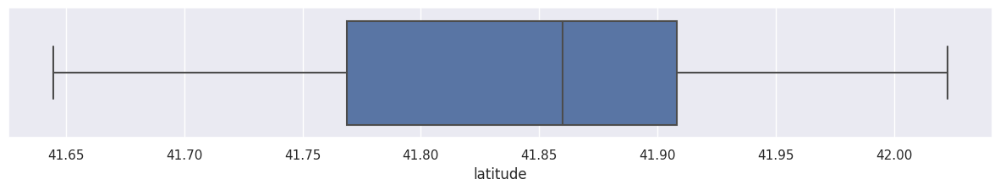

In [ ]:
plt.figure(figsize = (15, 2))
sns.boxplot(x='latitude', data=df)
plt.show()

In [ ]:
#df['longitude'].hist(bins=50, range=[-91, -87])

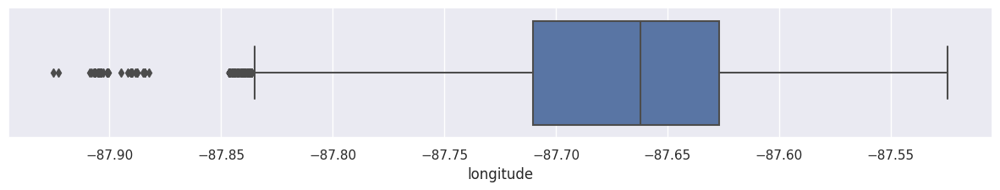

In [ ]:
plt.figure(figsize = (15, 2))
sns.boxplot(x='longitude', data=df)
plt.show()

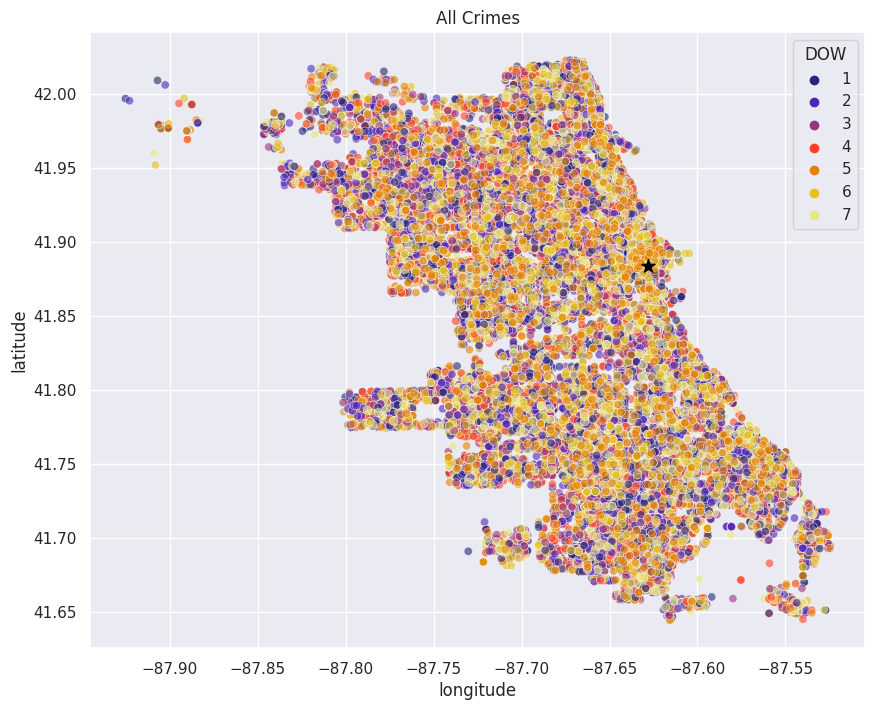

In [ ]:
# Plot location of all crimes, coloring by DOW
plt.figure(figsize = (10, 8))
sns.scatterplot(x='longitude', y='latitude', hue='DOW', palette='CMRmap', 
                hue_order=np.sort(df['DOW'].unique()), alpha=0.6, data=df).set(title='All Crimes')
plt.scatter(x=lon, y=lat, color='black', s=100, marker='*') # Include location with most crime
plt.show()

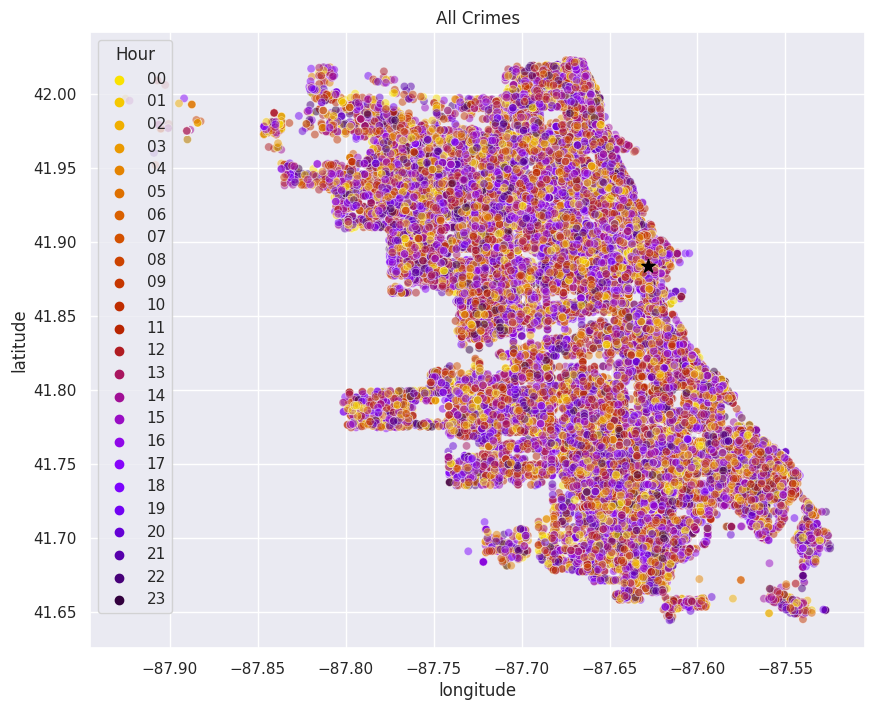

In [ ]:
# Plot location of all crimes, coloring by Hour of the day
plt.figure(figsize = (10, 8))
sns.scatterplot(x='longitude', y='latitude', hue='Hour', palette='gnuplot_r',
                hue_order=np.sort(df['Hour'].unique()), alpha=0.5, data=df).set(title='All Crimes')
plt.scatter(x=lon, y=lat, color='black', s=100, marker='*') # Include location with most crime
plt.show()

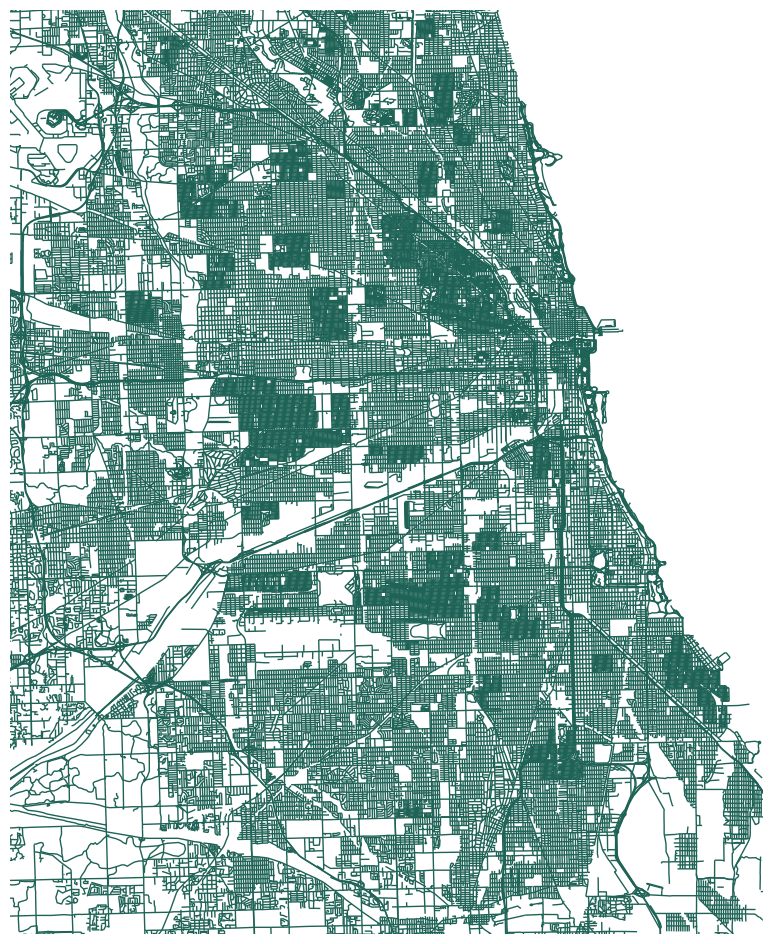

In [ ]:
# Generate a street map of all Chicagoland area
showMapAreaAndPoints(map_df, 
                     df['latitude'].min(), df['latitude'].max(),
                     df['longitude'].min(), df['longitude'].max())

/usr/local/lib/python3.10/dist-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


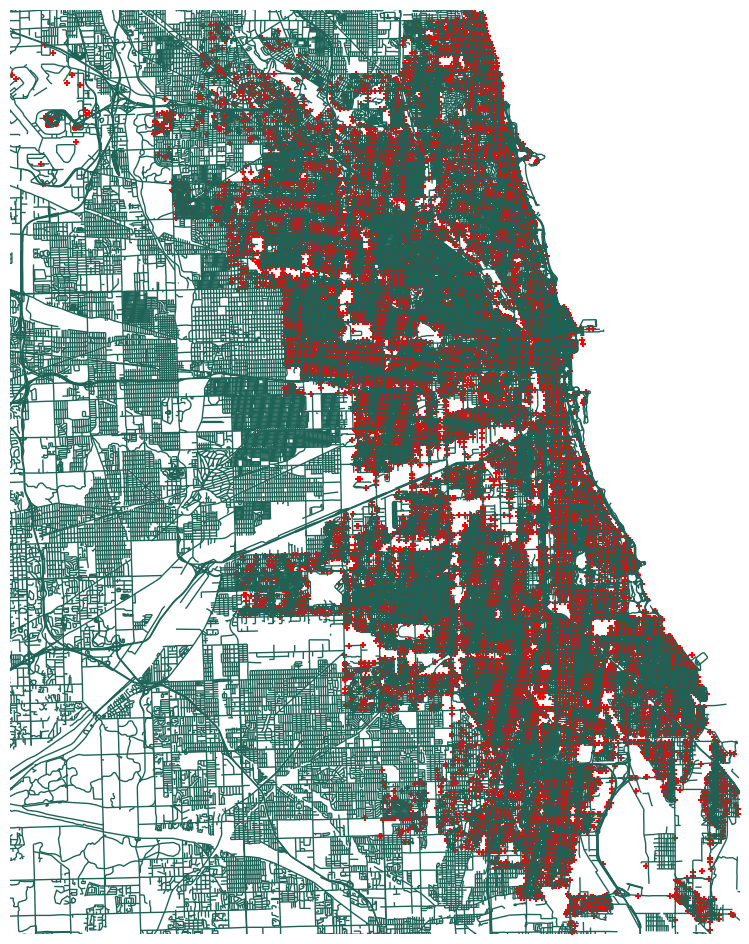

In [ ]:
# Generate streetmap highlighting crime points
tempDF = pd.DataFrame()
tempDF['latitude'] = df['latitude']
tempDF['longitude'] = df['longitude']
pointsDF = createGeoDataFrame(tempDF)

showMapAreaAndPoints(map_df, 
                     tempDF['latitude'].min(), tempDF['latitude'].max(),
                     tempDF['longitude'].min(), tempDF['longitude'].max(), 
                     pointsDF)

<Axes: xlabel='count', ylabel='date'>

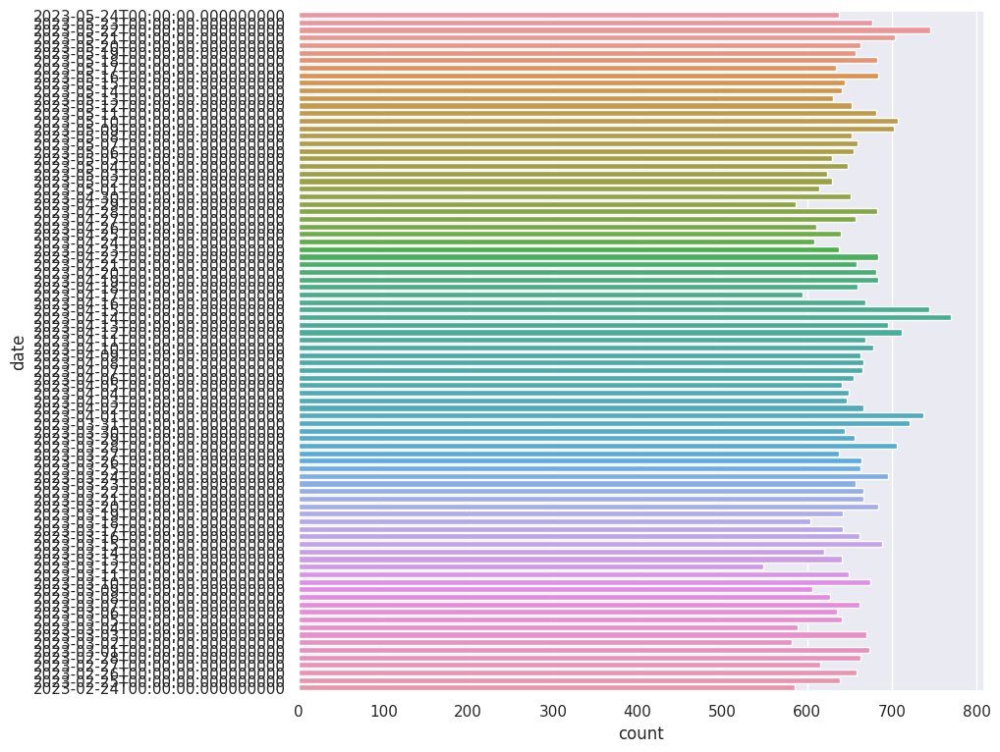

In [ ]:
sns.countplot(y=df["date"])

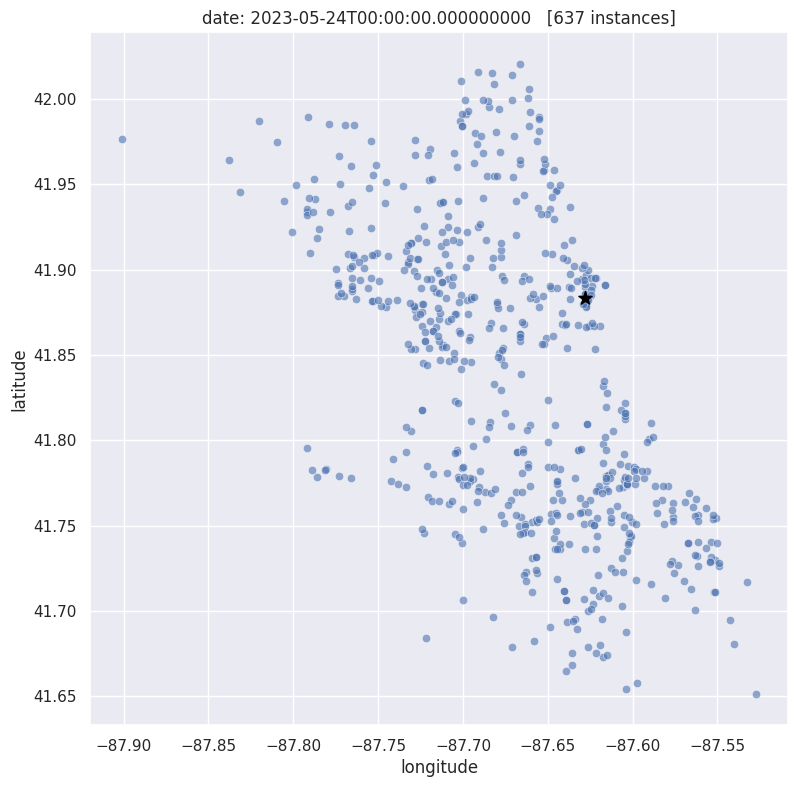

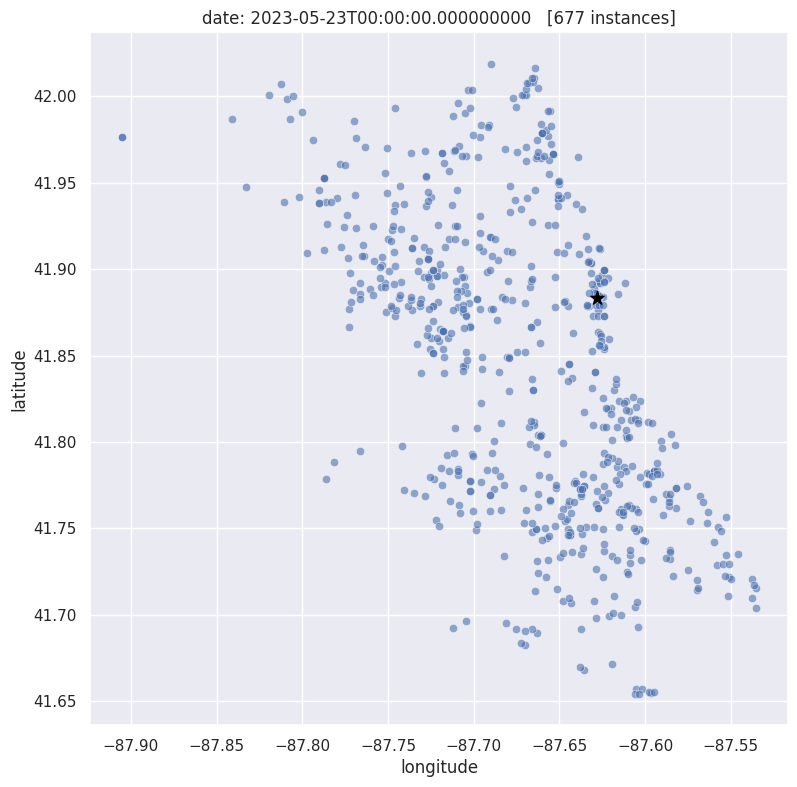

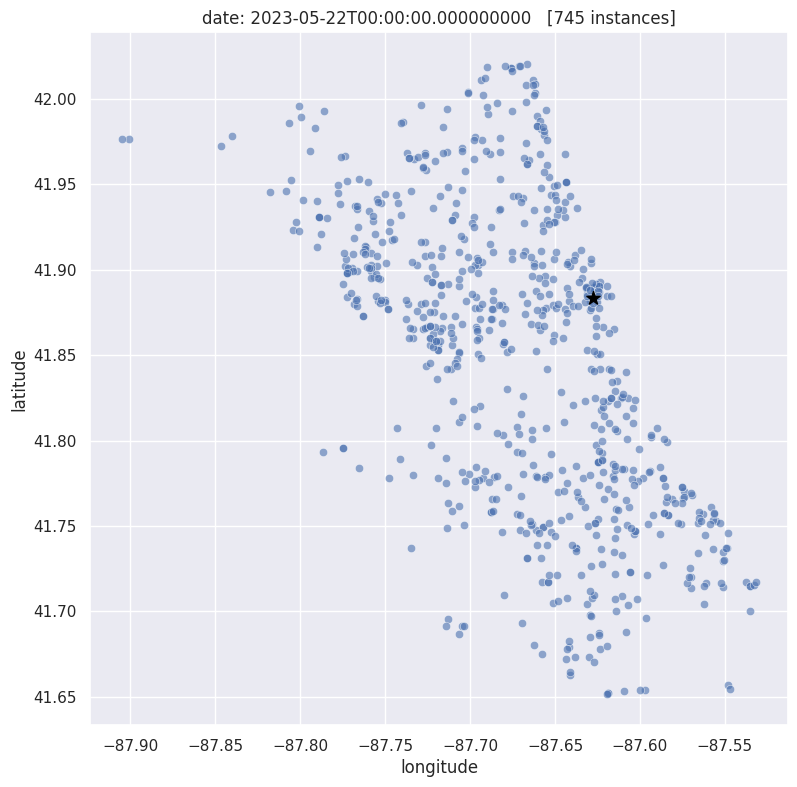

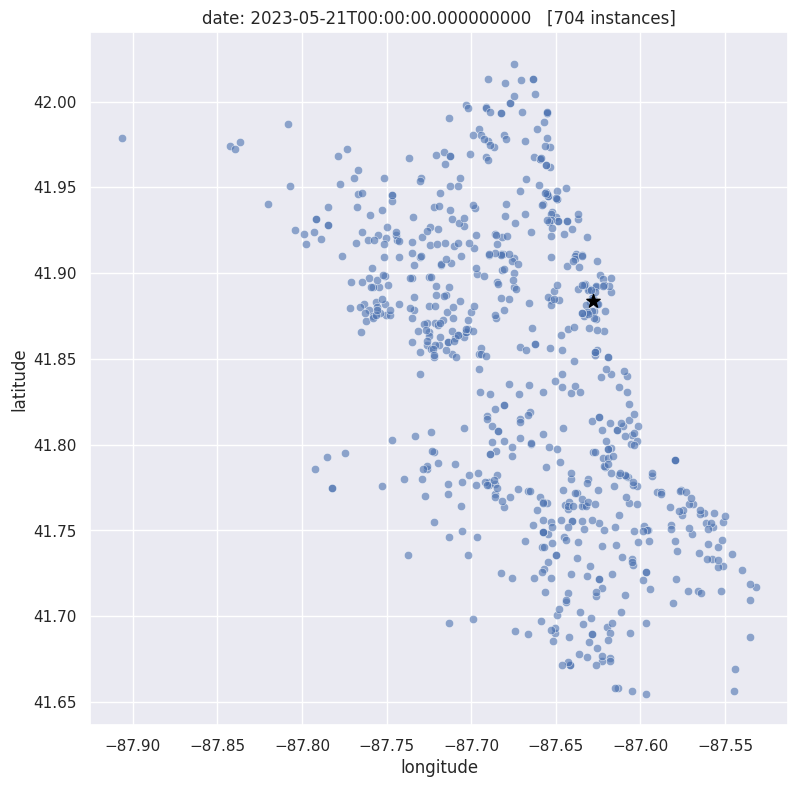

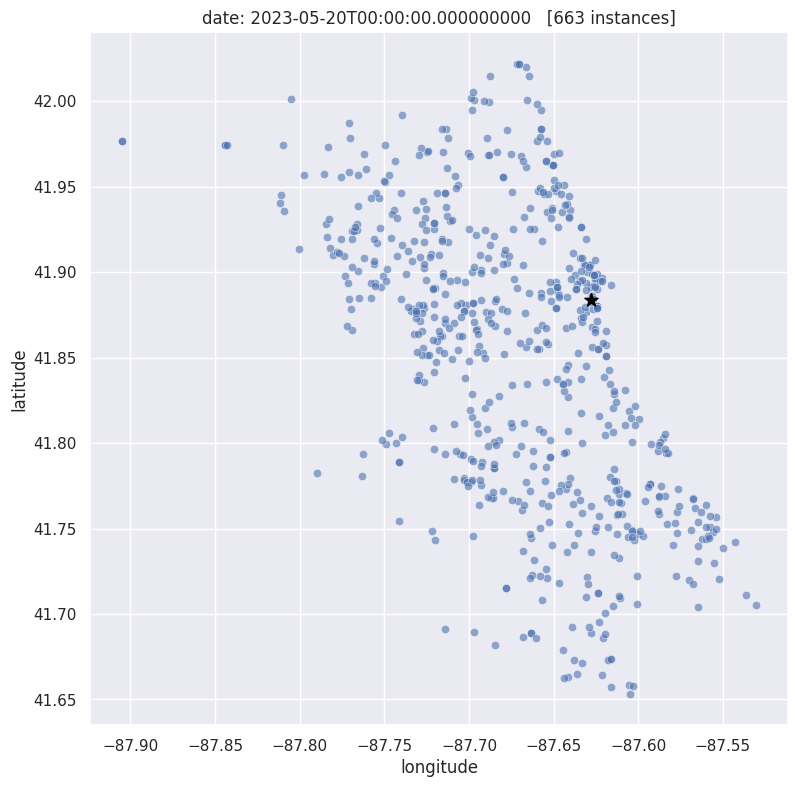

...

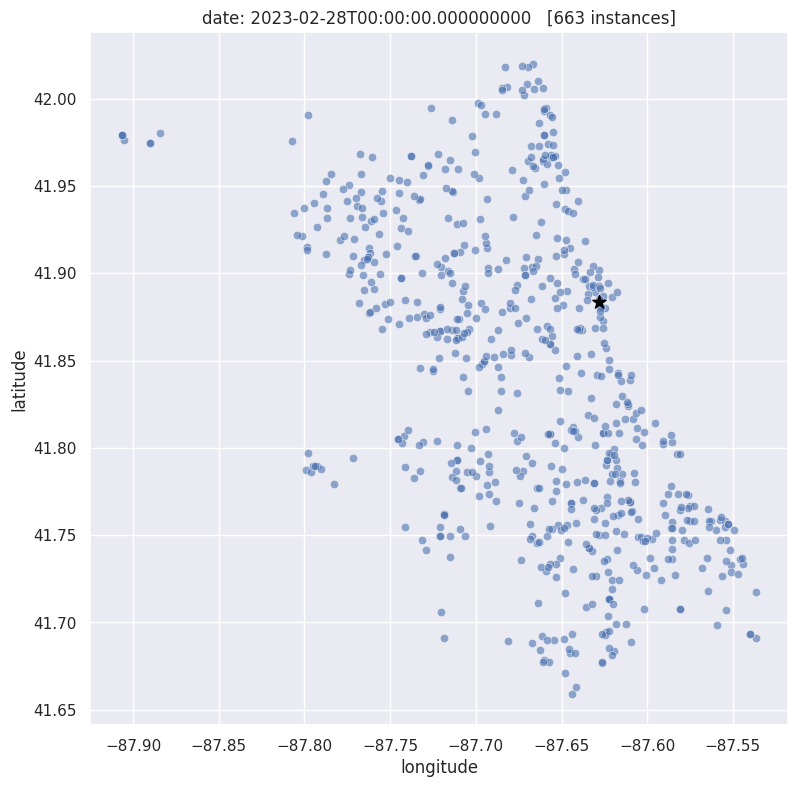

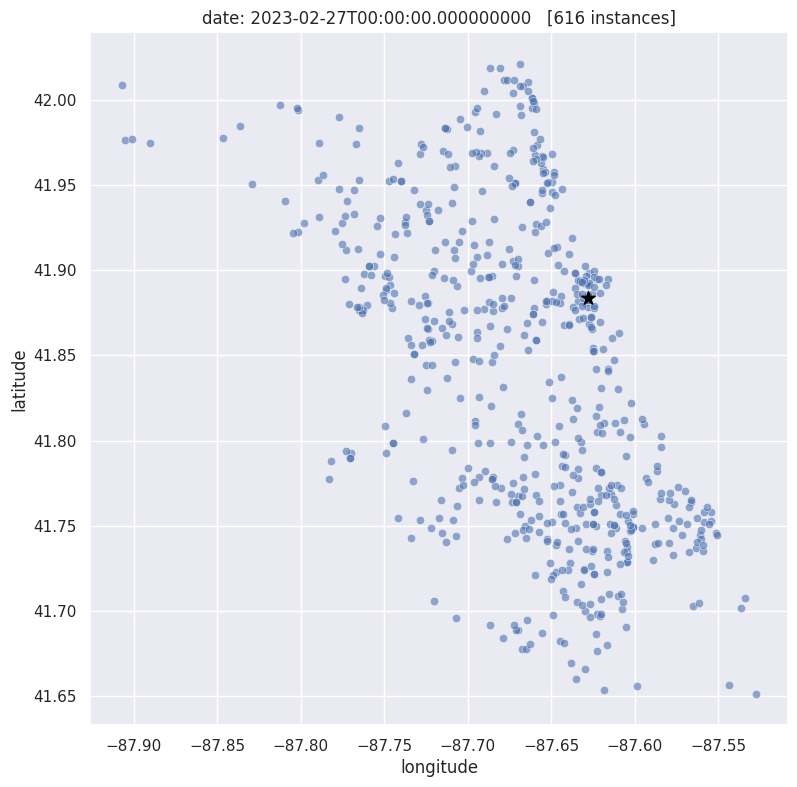

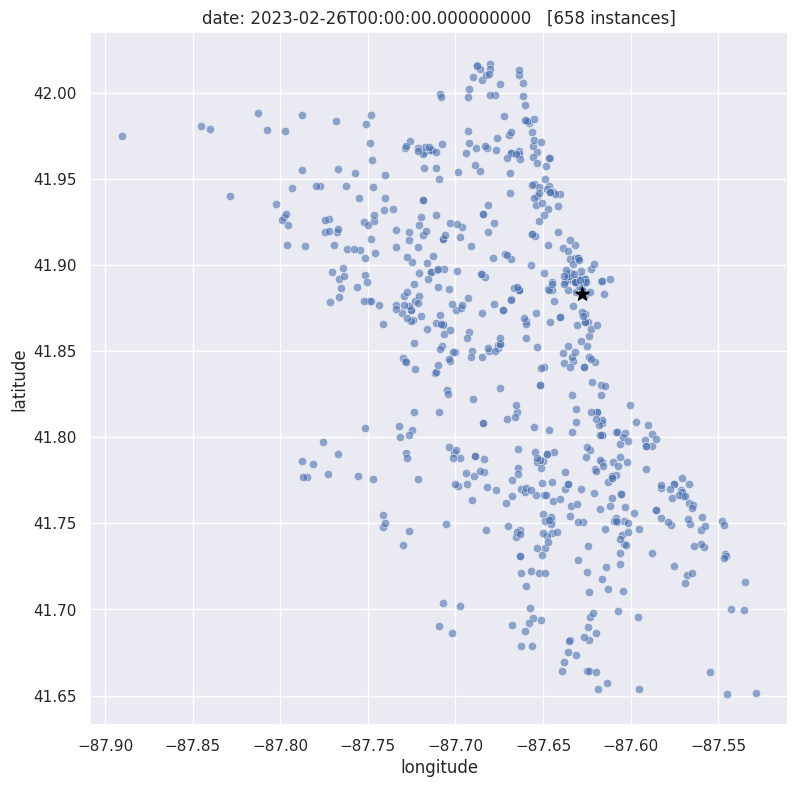

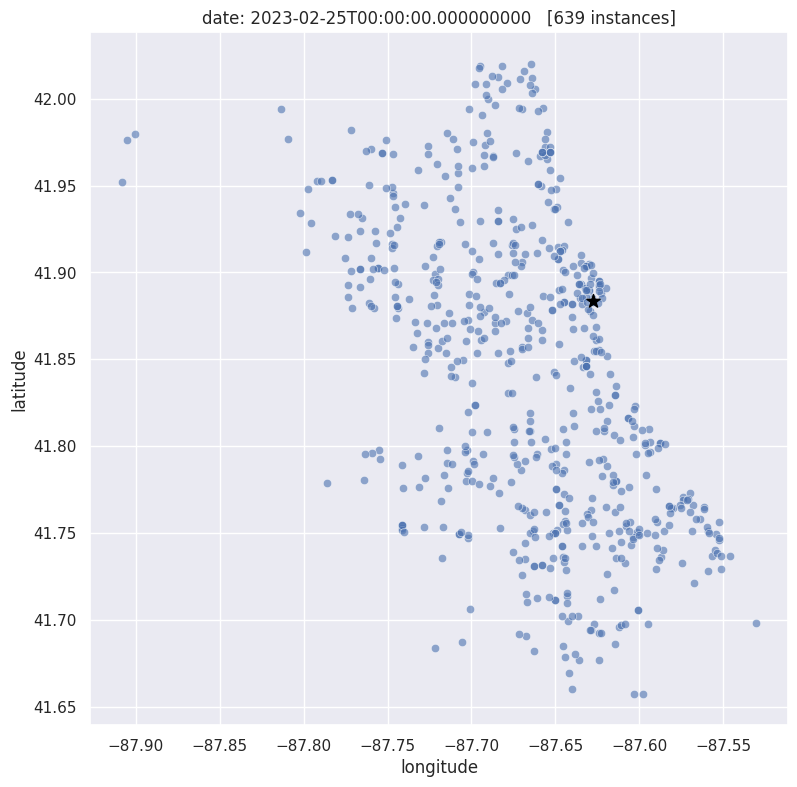

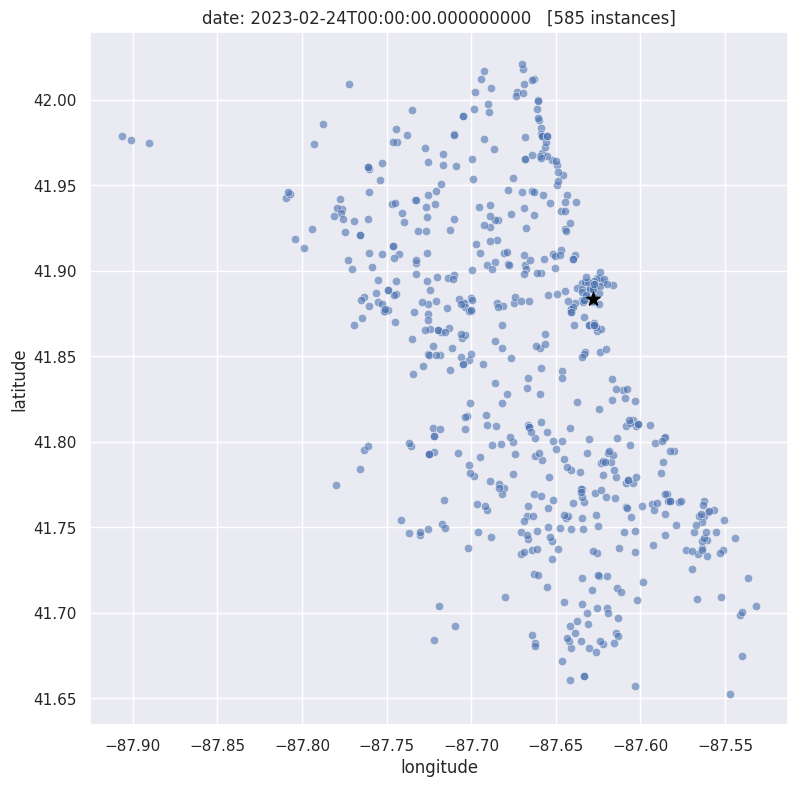

In [ ]:
# Plot crime location by values of date
scatterplotXYByCategory(df, 'longitude', 'latitude', 'date', None, (lat, lon))

<Axes: xlabel='count', ylabel='Hour'>

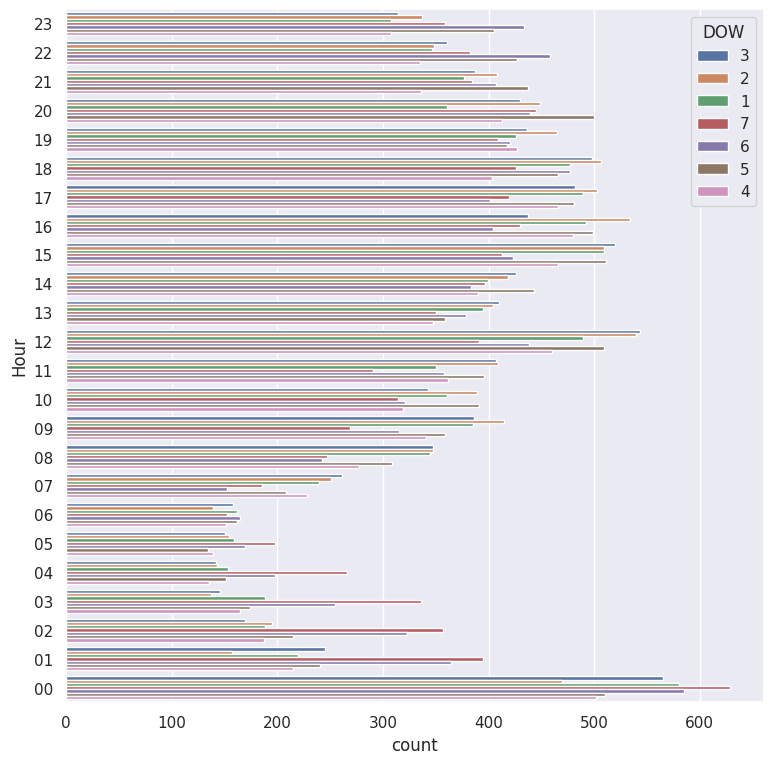

In [ ]:
sns.countplot(y=df["Hour"], hue=df["DOW"])

<Axes: xlabel='count', ylabel='primary_type'>

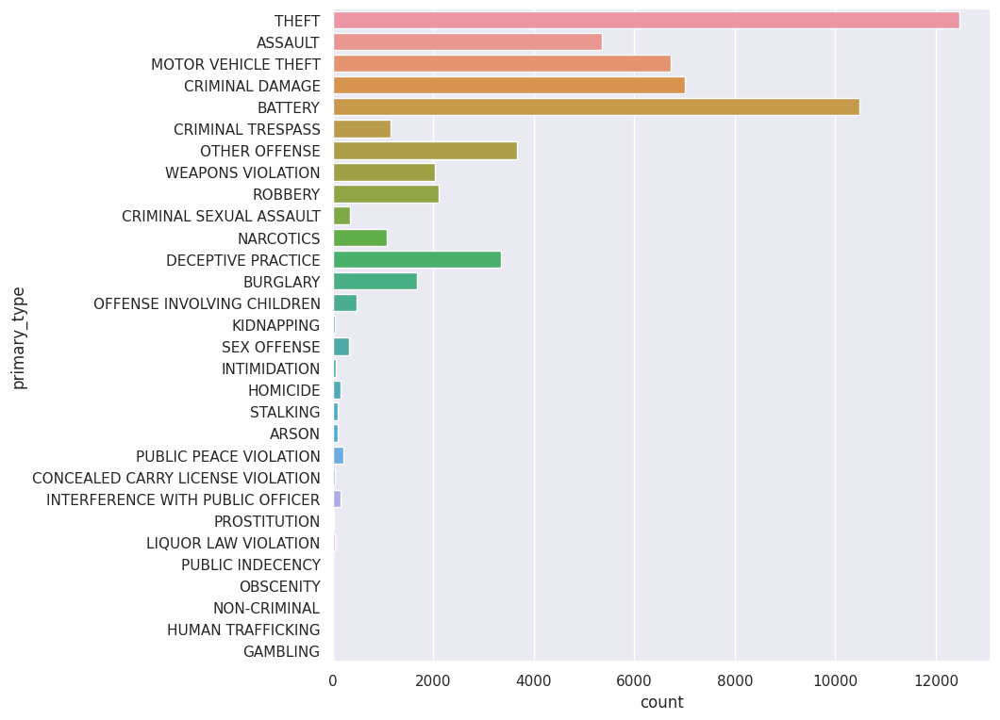

In [ ]:
sns.countplot(y=df["primary_type"])

<Axes: xlabel='count', ylabel='primary_type'>

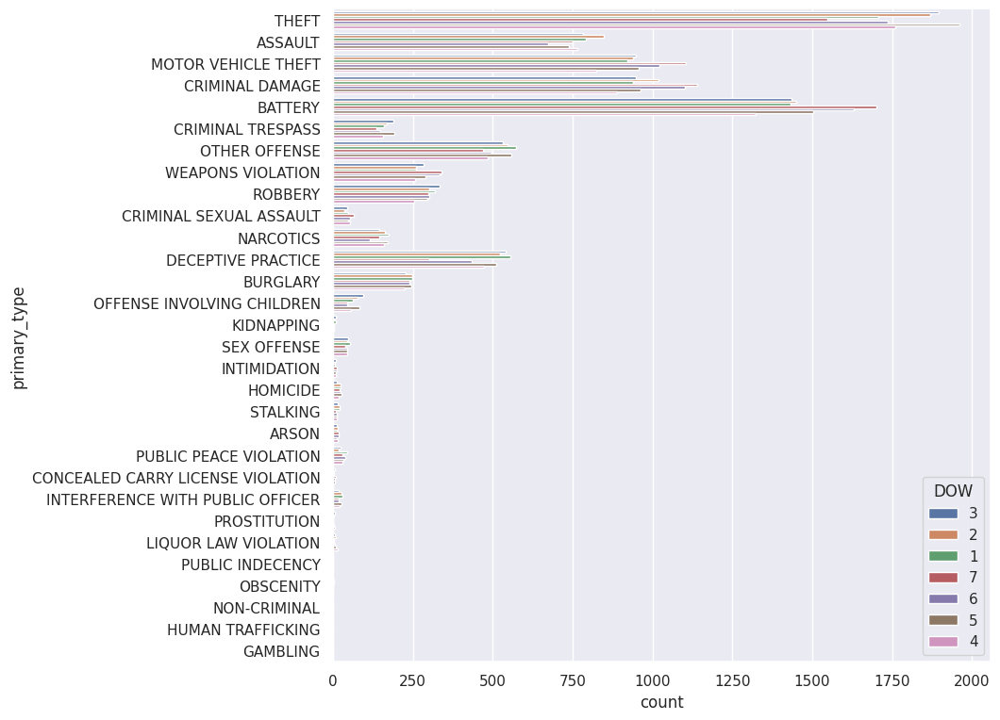

In [ ]:
sns.countplot(y=df["primary_type"], hue=df["DOW"])

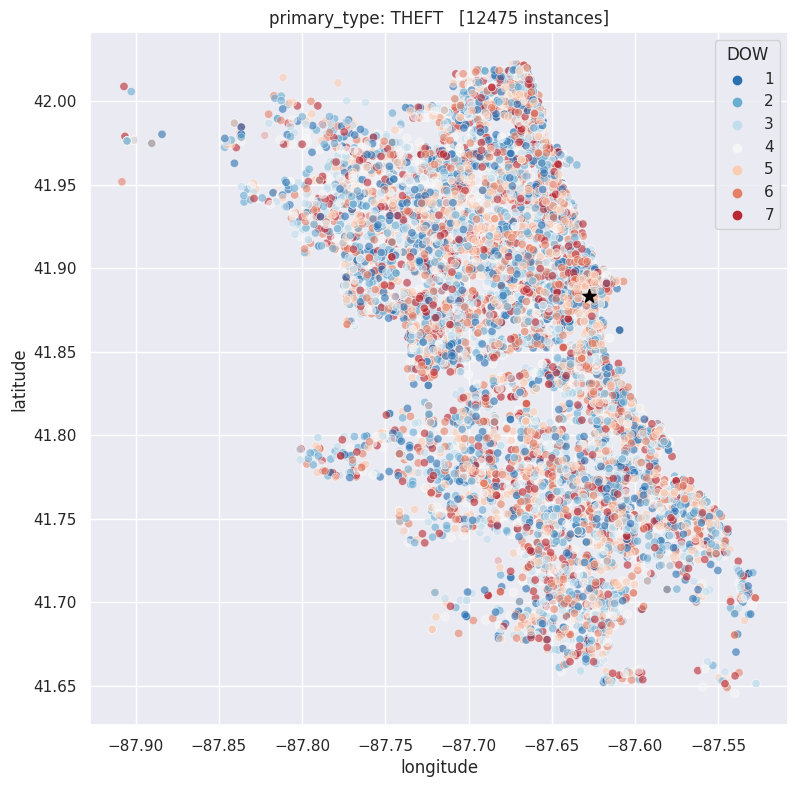

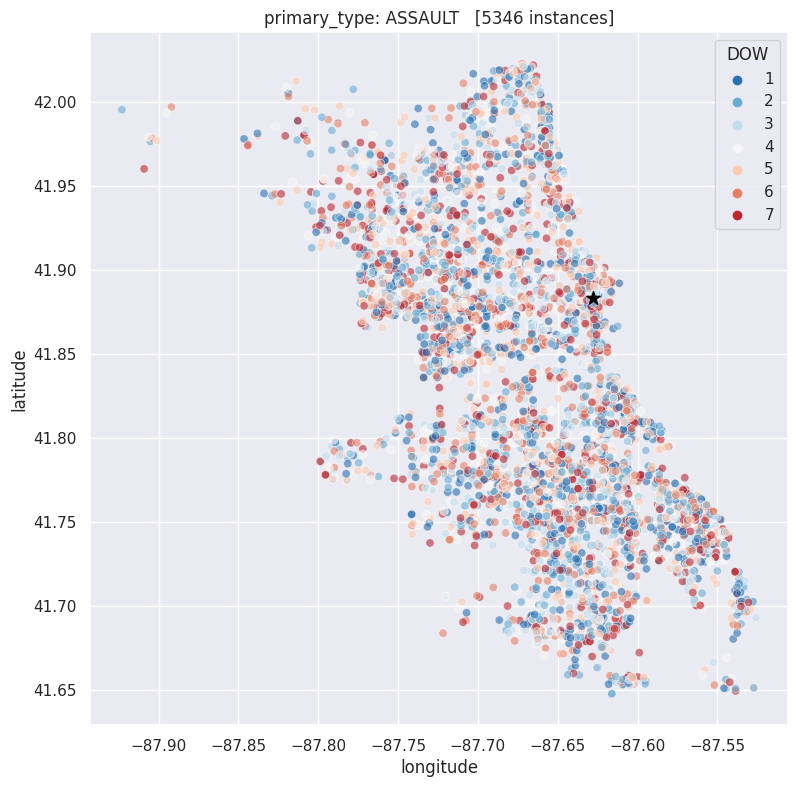

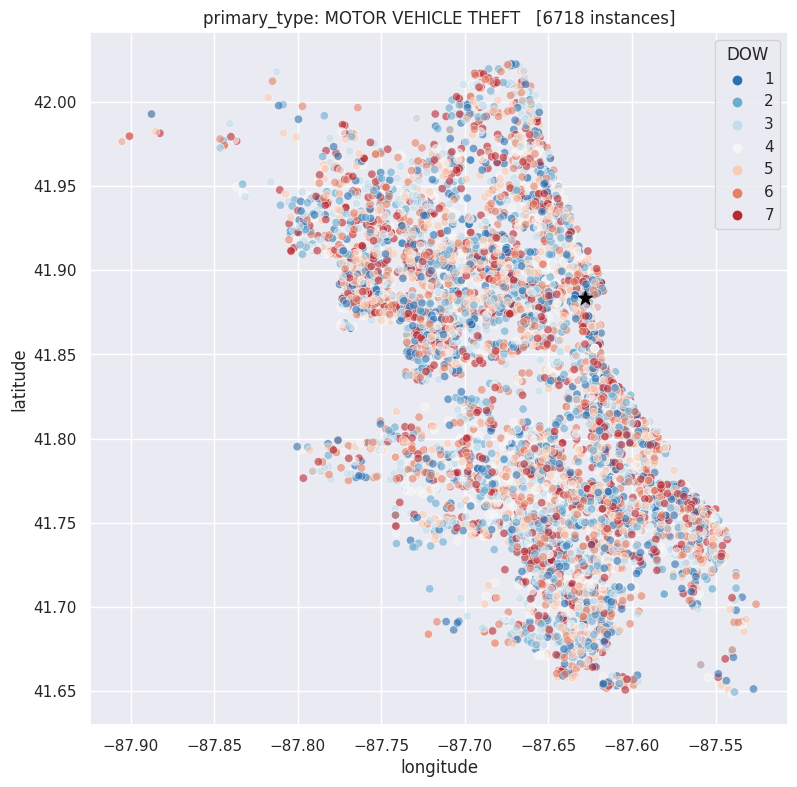

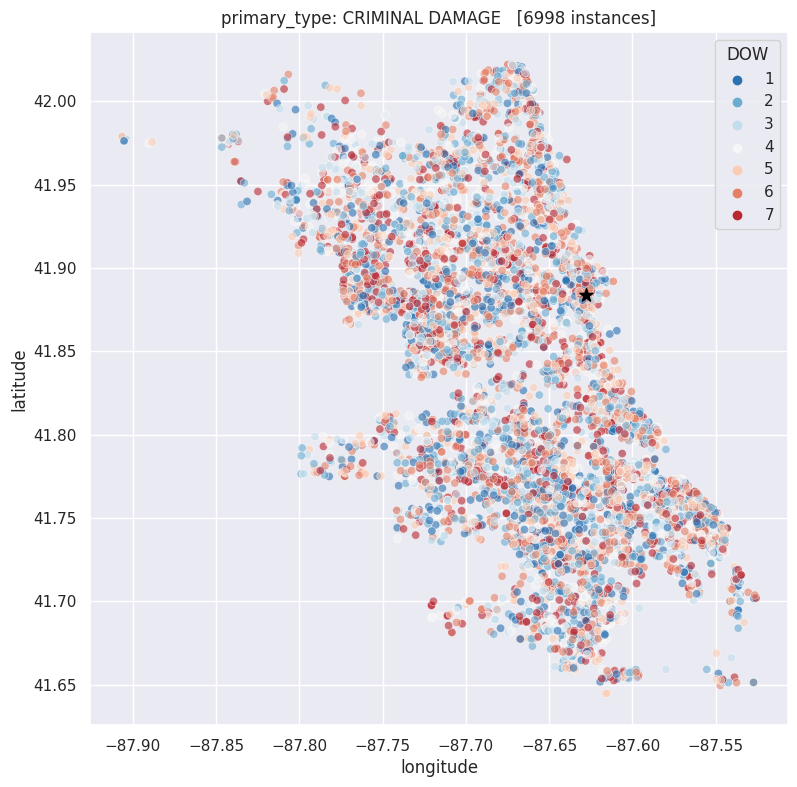

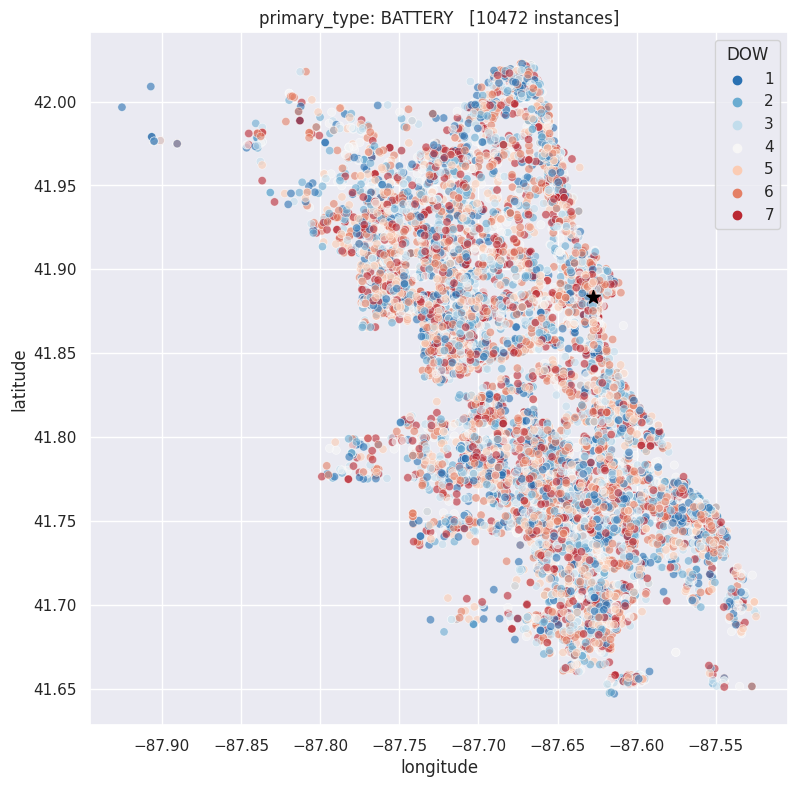

...

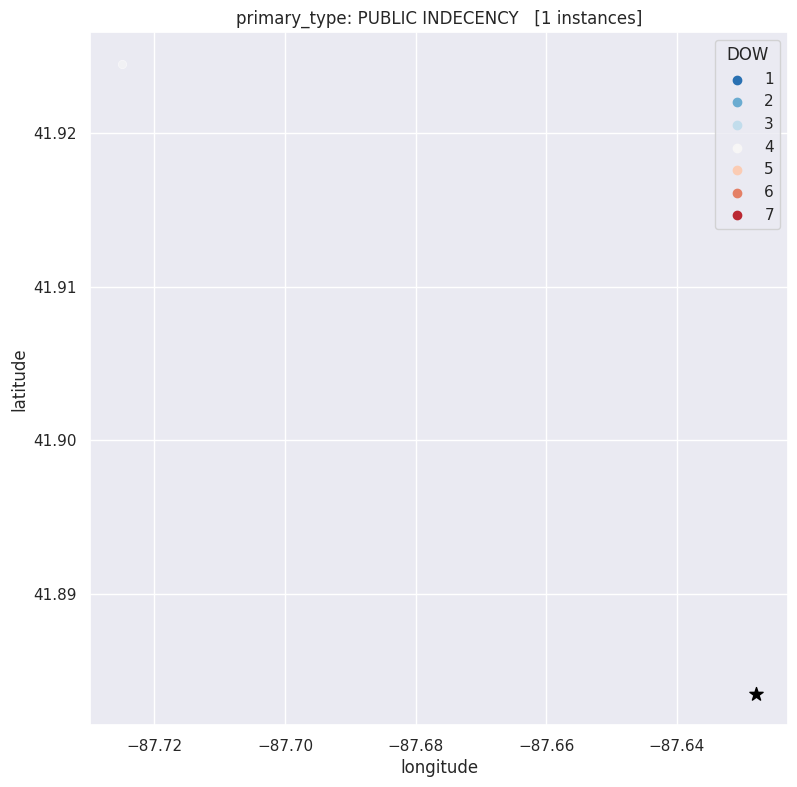

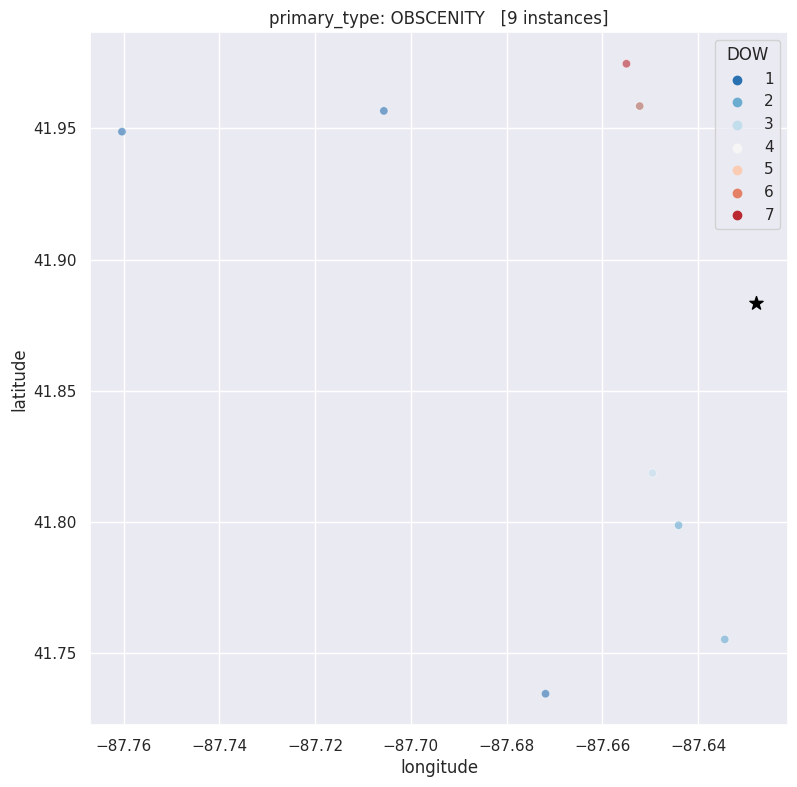

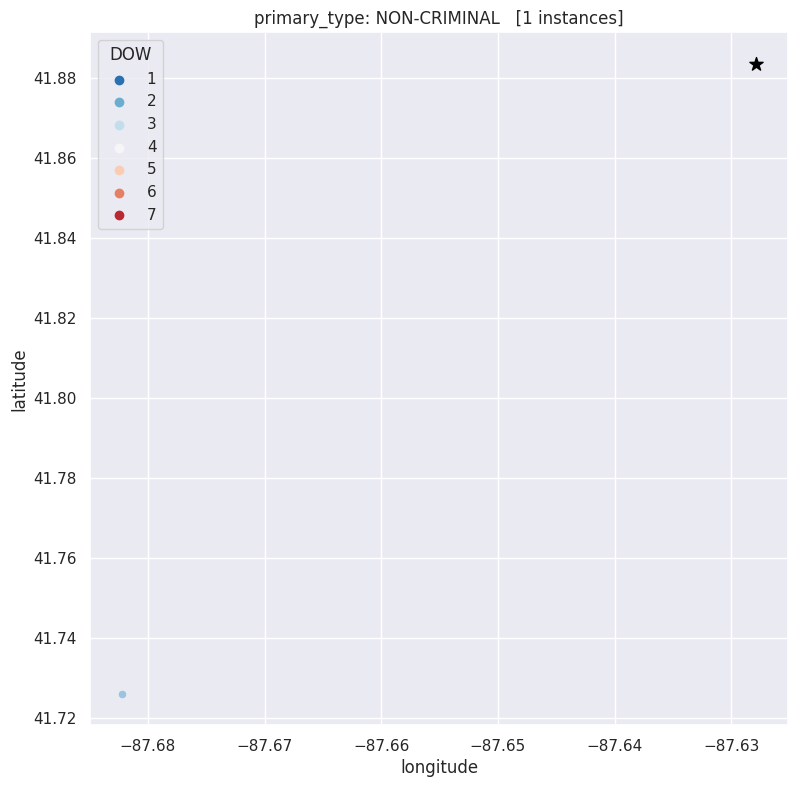

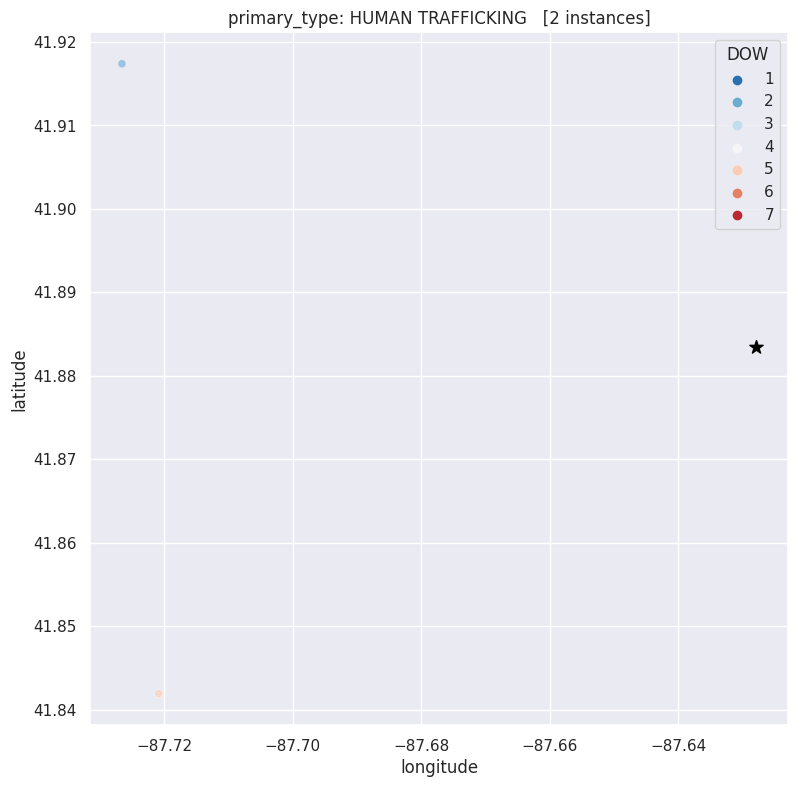

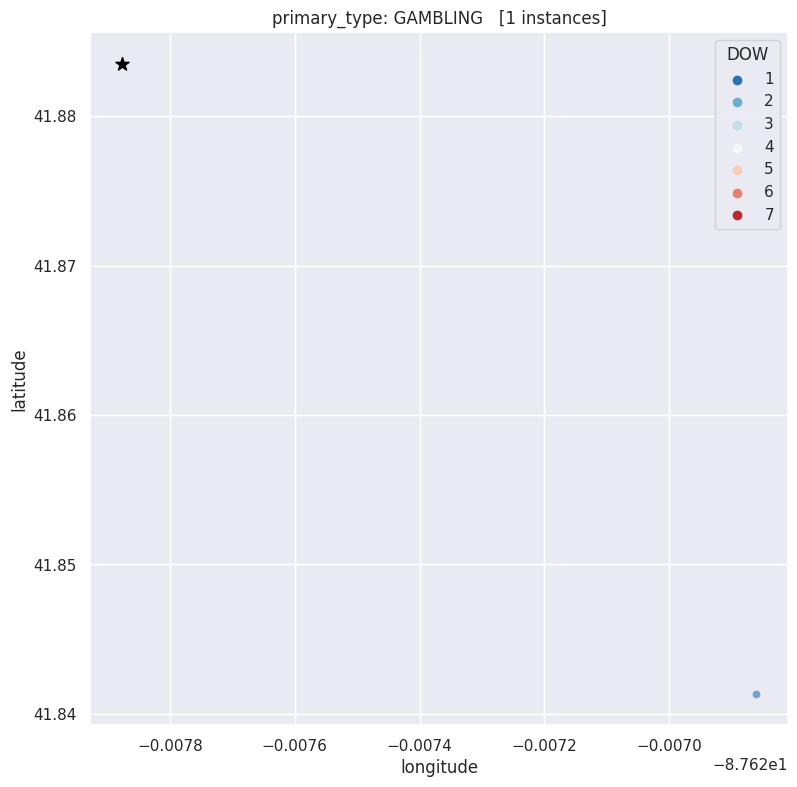

In [ ]:
# Plot crime location by values of Primary Type, and color points by Hour
scatterplotXYByCategory(df, 'longitude', 'latitude', 'primary_type', 'DOW', (lat, lon))

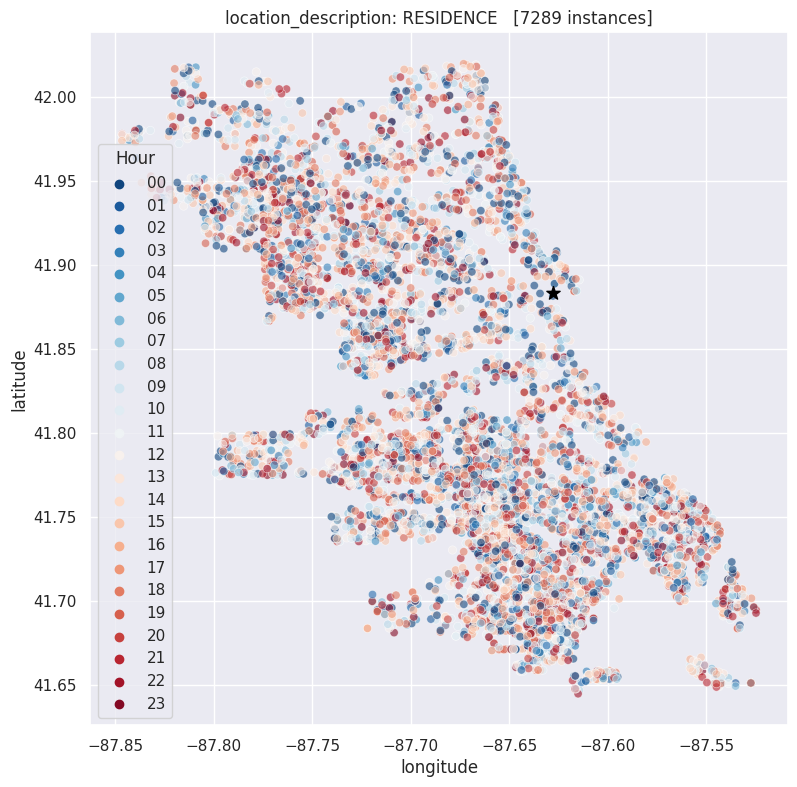

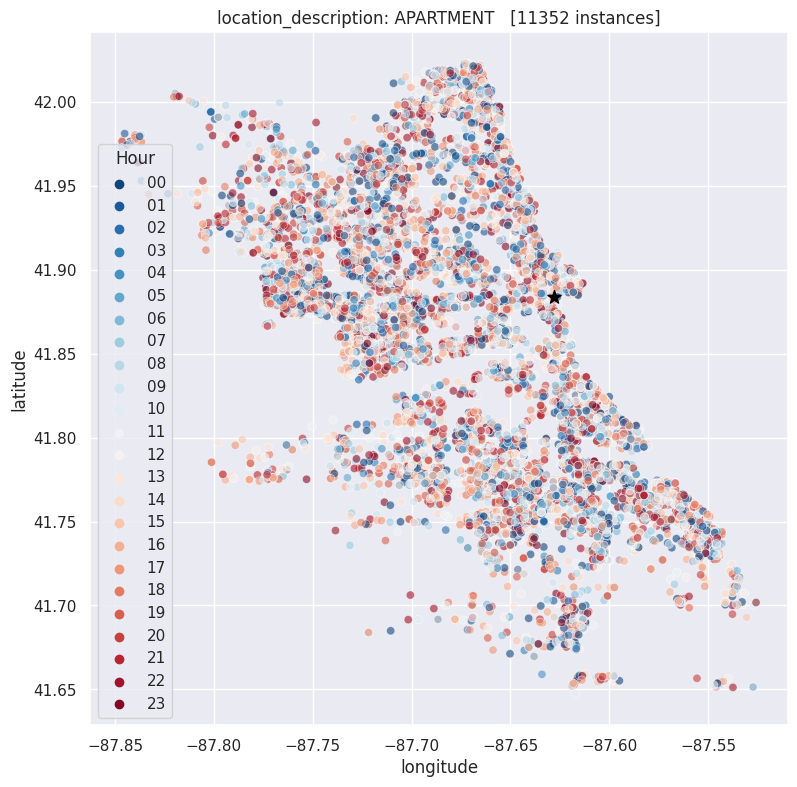

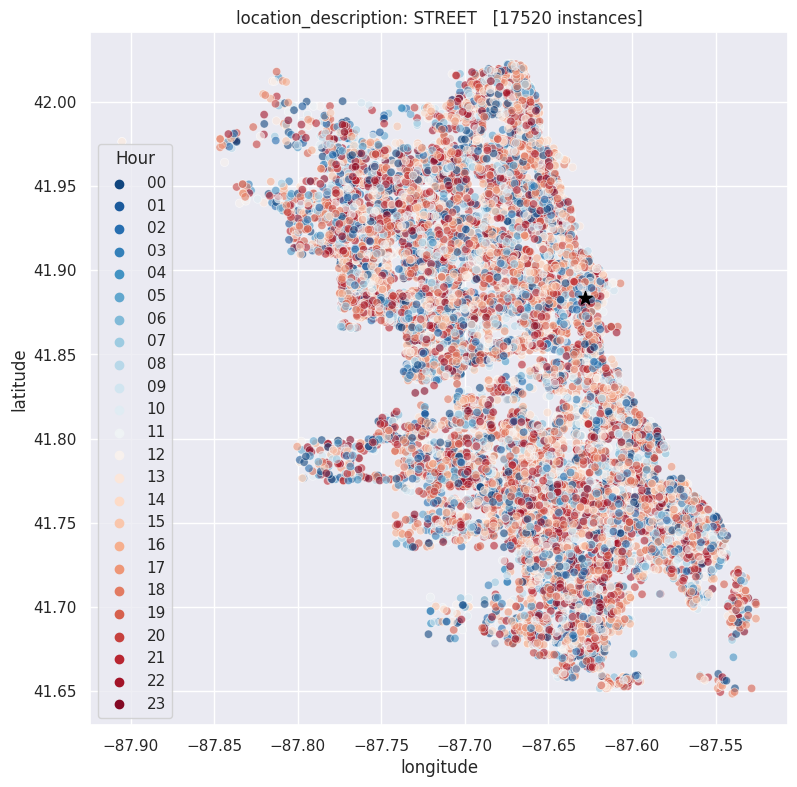

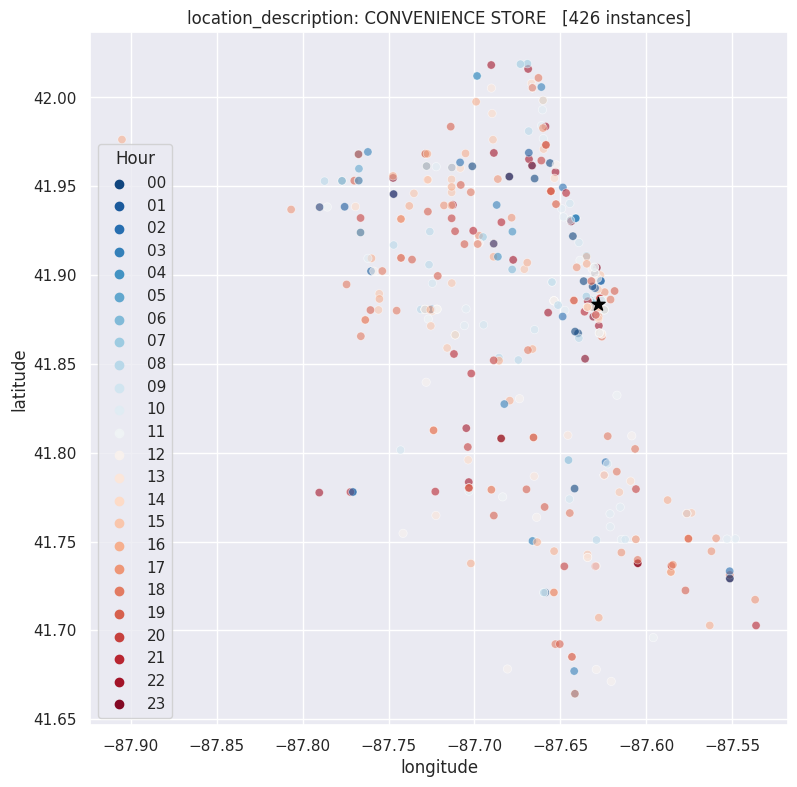

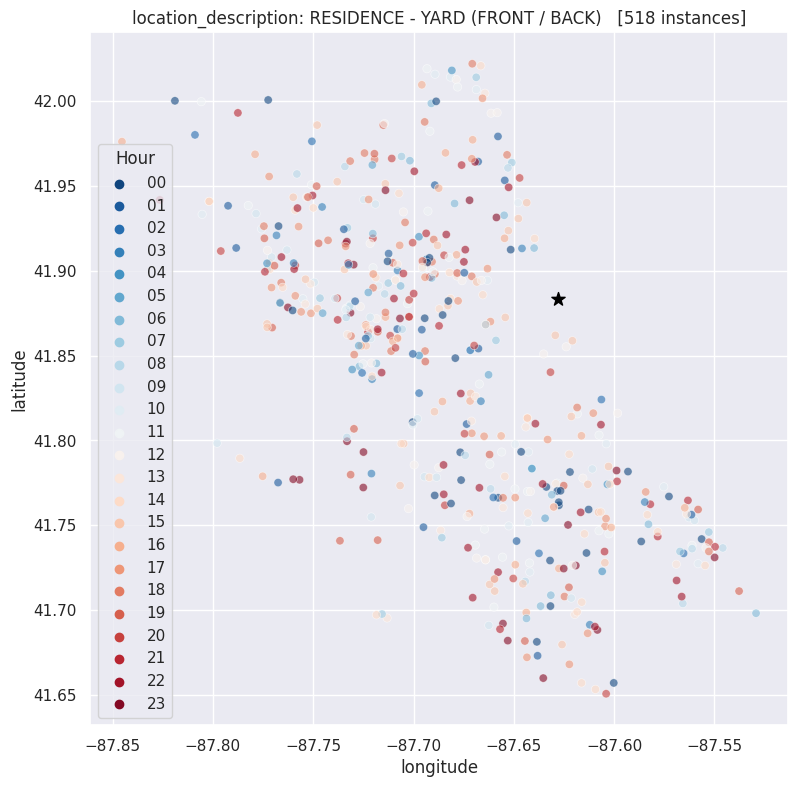

...

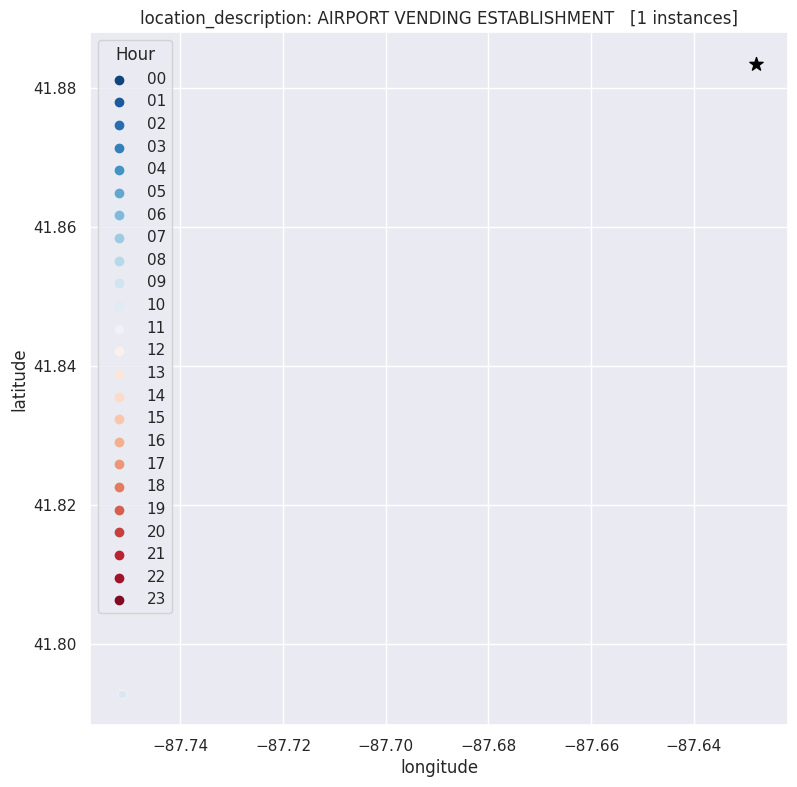

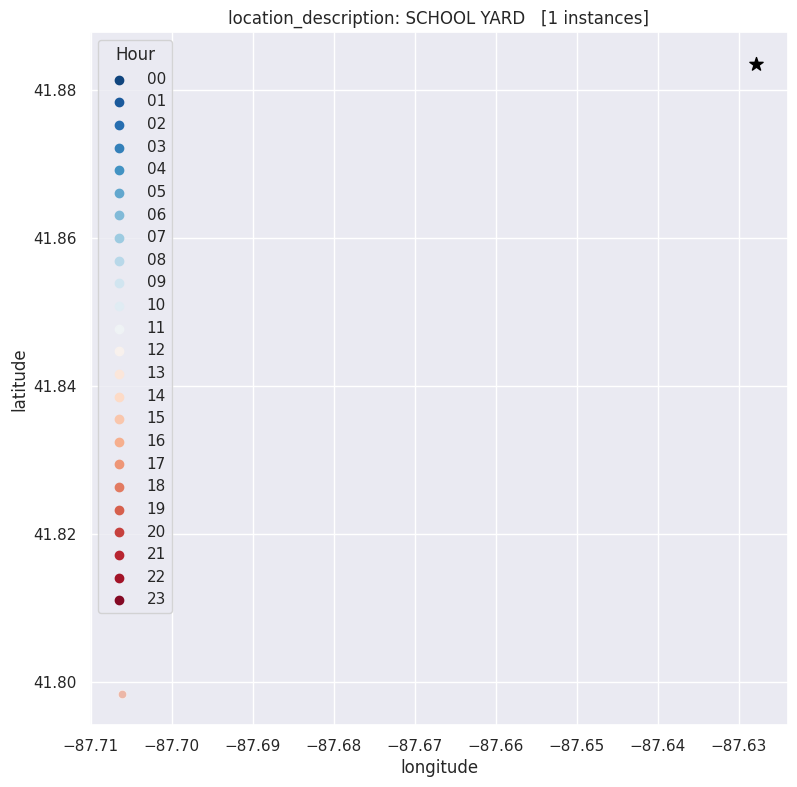

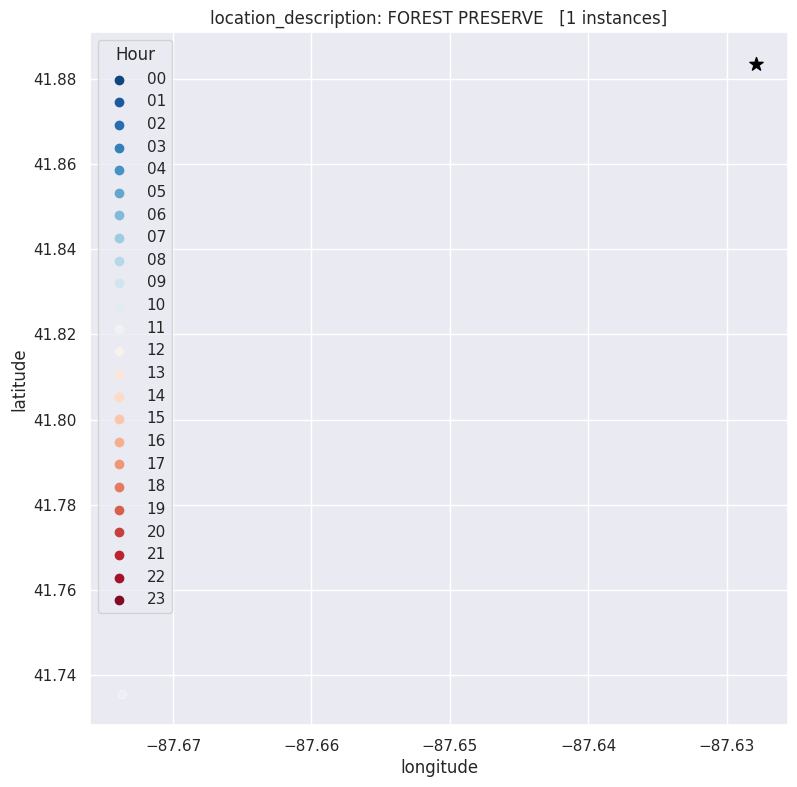

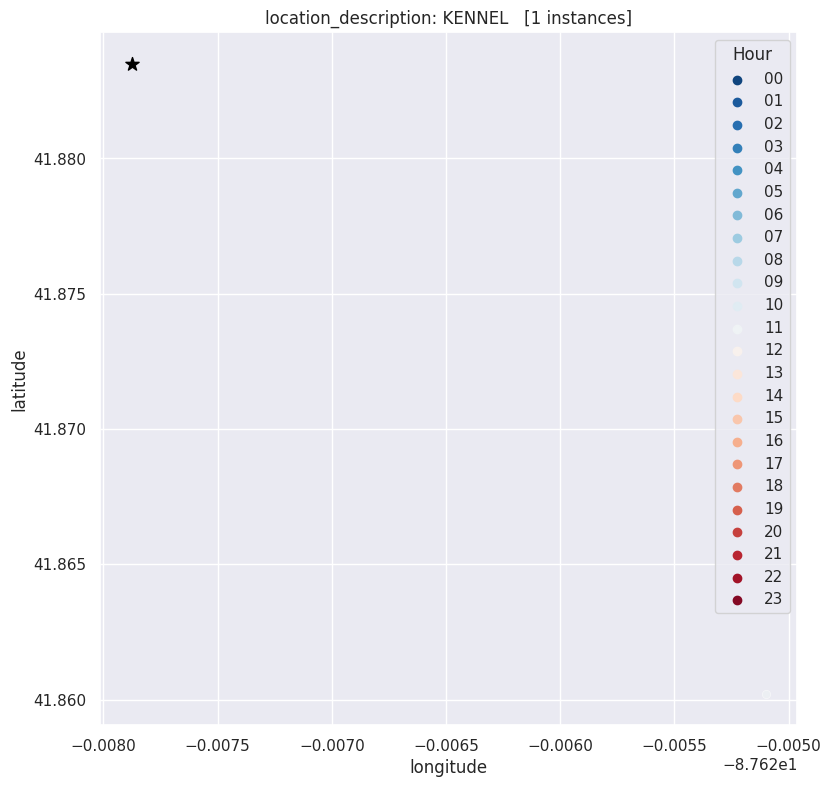

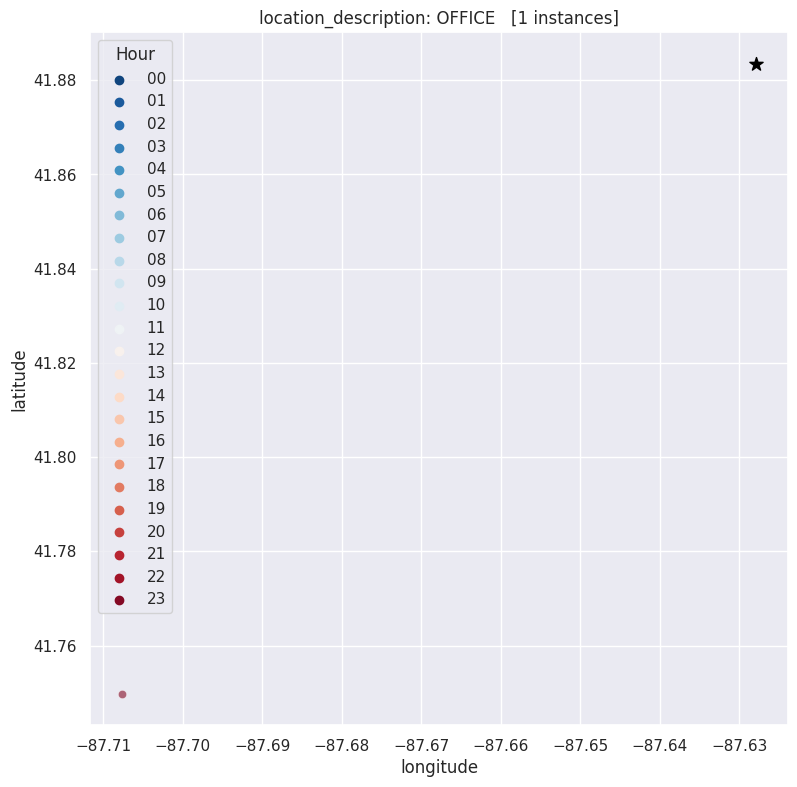

In [ ]:
# Plot crime location by values of Location Description, and color points by DOW
scatterplotXYByCategory(df, 'longitude', 'latitude', 'location_description', 'Hour', (lat, lon))

# Load dataframe to in-memory DB

In [ ]:
# Create a SQLite connection in memory
conn = sqlite3.connect(':memory:')

# Write the data to a SQLite table
df.to_sql('ChicagoCrime', conn, if_exists='replace', index=False)

59097

In [ ]:
query = "SELECT location_description, COUNT(*) AS cnt \
FROM ChicagoCrime \
WHERE date > '2023-01-01' \
GROUP BY location_description \
ORDER BY cnt DESC \
LIMIT 10;"

pd.read_sql_query(query, conn)

,location_description,cnt
0,STREET,17520
1,APARTMENT,11352
2,RESIDENCE,7289
3,SIDEWALK,2675
4,PARKING LOT / GARAGE (NON RESIDENTIAL),2305
5,SMALL RETAIL STORE,1637
6,ALLEY,1377
7,RESTAURANT,1245
8,DEPARTMENT STORE,875
9,COMMERCIAL / BUSINESS OFFICE,863


In [ ]:
query = "SELECT latitude, longitude, COUNT(*) AS cnt \
FROM ChicagoCrime \
WHERE date > '2023-01-01' \
GROUP BY latitude, longitude \
ORDER BY cnt DESC \
LIMIT 20;"

pd.read_sql_query(query, conn)
# Top two locations:
# 108 N State St
# 190 N State St

,latitude,longitude,cnt
0,41.883500,-87.627877,116
1,41.885482,-87.627936,103
2,41.788987,-87.741480,73
3,41.754593,-87.741529,68
4,41.976290,-87.905227,59
5,41.963071,-87.655984,55
6,41.909290,-87.647258,49
7,41.891405,-87.628062,48
8,41.891695,-87.626156,47
9,41.868542,-87.639235,46


In [ ]:
# Address is 108 N State St
query = "SELECT location_description, COUNT(*) AS cnt \
FROM ChicagoCrime \
WHERE date > '2023-01-01' \
AND latitude >= 41.883499 AND latitude <= 41.883501 \
AND longitude >= -87.627878 AND longitude <= -87.627876 \
GROUP BY location_description \
ORDER BY cnt DESC \
LIMIT 20;"

pd.read_sql_query(query, conn)

,location_description,cnt
0,DEPARTMENT STORE,82
1,SMALL RETAIL STORE,27
2,COMMERCIAL / BUSINESS OFFICE,4
3,SIDEWALK,2
4,OTHER (SPECIFY),1


# Specify address of interest

In [ ]:
# Creates widgets to enter address to explore and get Latitude/Longitude for it.
import ipywidgets as widgets
from IPython.display import display

def on_click(_):
    address = address_input.value
    try:
        latitude, longitude = find_address_ccordinates(address)
        latitude_Result.value = latitude
        longitude_Result.value = longitude
    except Exception as e:
        print(f"Error: {e}")

address_input = widgets.Textarea(
    placeholder="Enter address to locate here....",
    layout=widgets.Layout(width="50%", height="40px")
)
query_button = widgets.Button(
    description="Find Coordinates",
    button_style="info"
)
latitude_Result = widgets.FloatText(
    value=0.0,
    description='LAT:',
    disabled=False
)
longitude_Result = widgets.FloatText(
    value=0.0,
    description='LON:',
    disabled=False
)
numDays_input = widgets.IntSlider(
    value=20,
    min=20,
    max=360,
    step=20,
    description='Num. Days:',
    disabled=False,
    continuous_update=False,
    orientation='horizontal',
    readout=True,
    readout_format='d'
)
numBlocks_input = widgets.IntSlider(
    value=5,
    min=2,
    max=20,
    step=1,
    description='Num. Blocks:',
    disabled=False,
    continuous_update=False,
    orientation='horizontal',
    readout=True,
    readout_format='d'
)

query_button.on_click(on_click)
display(address_input, numDays_input, numBlocks_input, query_button, latitude_Result, longitude_Result)

Textarea(value='', layout=Layout(height='40px', width='50%'), placeholder='Enter address to locate here....')

IntSlider(value=20, continuous_update=False, description='Num. Days:', max=360, min=20, step=20)

IntSlider(value=5, continuous_update=False, description='Num. Blocks:', max=20, min=2)

Button(button_style='info', description='Find Coordinates', style=ButtonStyle())

FloatText(value=0.0, description='LAT:')

FloatText(value=0.0, description='LON:')

In [ ]:
# Parameters to be used for the rest of the analysis
Address = address_input.value
Addr_Lat = latitude_Result.value
Addr_Lon = longitude_Result.value
numDays = numDays_input.value
NumBlocks = numBlocks_input.value
Address_Comp = "%s (%0.5f, %0.5f) - %d block radius - Last %d days" % (Address, Addr_Lat, Addr_Lon, NumBlocks, numDays)
print(Address_Comp)

150 S, Bell St Chicago IL (41.87891, -87.68277) - 5 block radius - Last 40 days


In [ ]:
# Radius equivalent to 1 block (this is my approximation)
Lat_Radius = 0.00050
Lon_Radius = 0.00200

# Calculate coordinates of area to explore
Min_Lat = Addr_Lat - (NumBlocks * Lat_Radius)
Max_Lat = Addr_Lat + (NumBlocks * Lat_Radius)

Min_Lon = Addr_Lon - (NumBlocks * Lon_Radius)
Max_Lon = Addr_Lon + (NumBlocks * Lon_Radius)

In [ ]:
# Filter original dataset to include crimes in the rectangle defined
newDF = resultsInsideCoordinates(Min_Lat, Max_Lat, Min_Lon, Max_Lon, numDays)
newDF.shape

(234, 21)

/usr/local/lib/python3.10/dist-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
/usr/local/lib/python3.10/dist-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


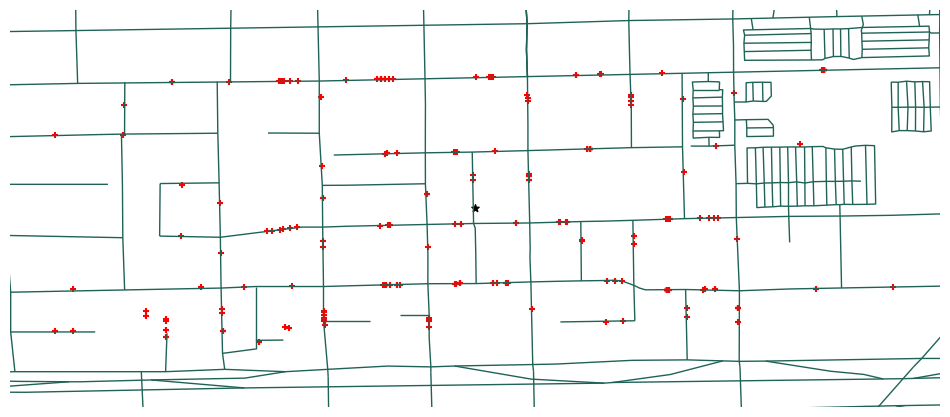

In [ ]:
# Generate streetmap highlighting crime points
# Create a new dataframe with crime coordinates
tempDF = pd.DataFrame()
tempDF['latitude'] = newDF['latitude']
tempDF['longitude'] = newDF['longitude']
pointsDF = createGeoDataFrame(tempDF)
# Create second dataframe with address coordinates
tempDF2 = pd.DataFrame([[Addr_Lat, Addr_Lon]], columns=['latitude', 'longitude'])
mainPointDF = createGeoDataFrame(tempDF2)

showMapAreaAndPoints(map_df, Min_Lat, Max_Lat, Min_Lon, Max_Lon, pointsDF, mainPointDF)

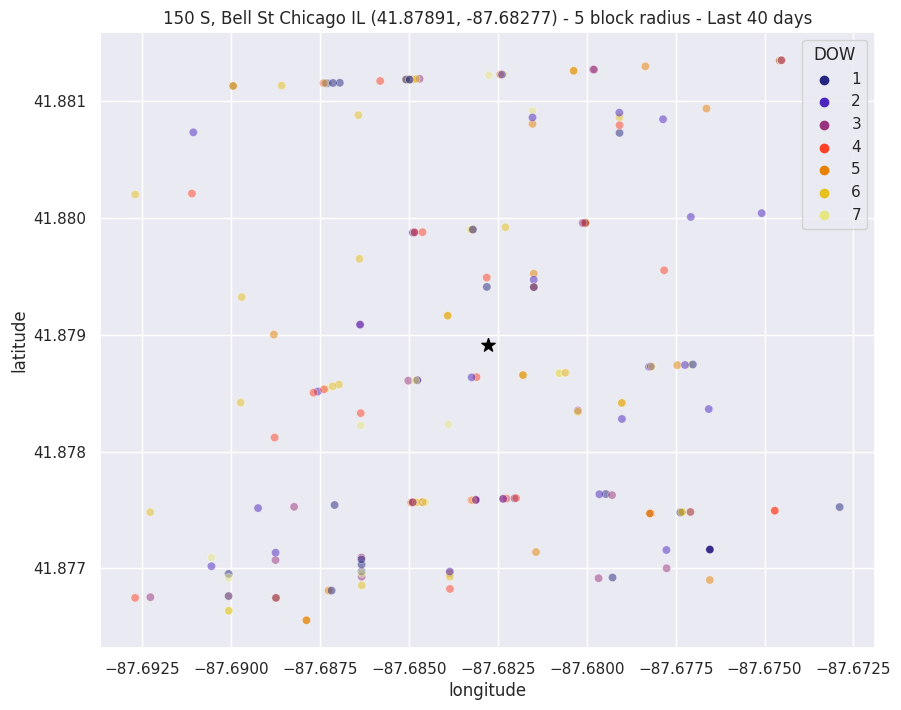

In [ ]:
# Plot filtered crimes
plt.figure(figsize = (10, 8))
sns.scatterplot(x='longitude', y='latitude', hue='DOW', palette='CMRmap', 
                hue_order=np.sort(df['DOW'].unique()), alpha=0.5, data=newDF).set(title=Address_Comp)
plt.scatter(x=Addr_Lon, y=Addr_Lat, color='black', s=100, marker='*') # Include reference address
plt.show()

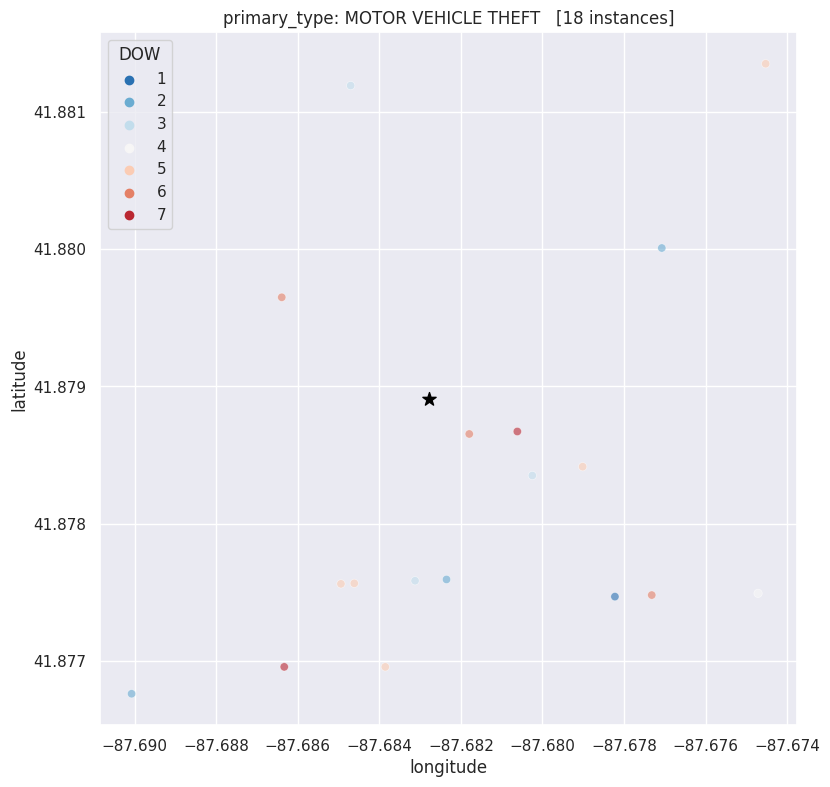

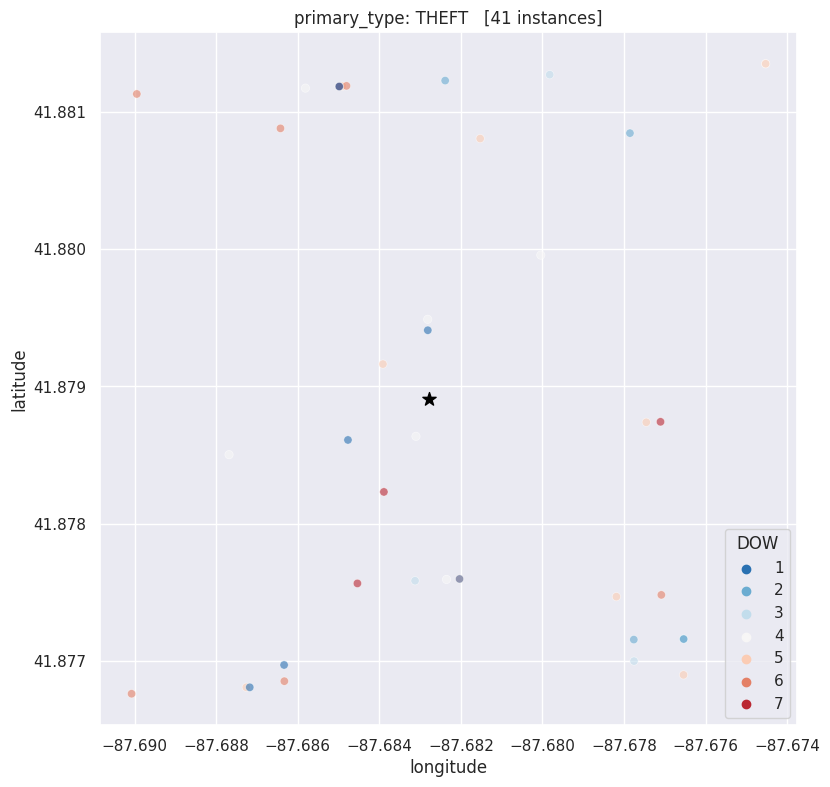

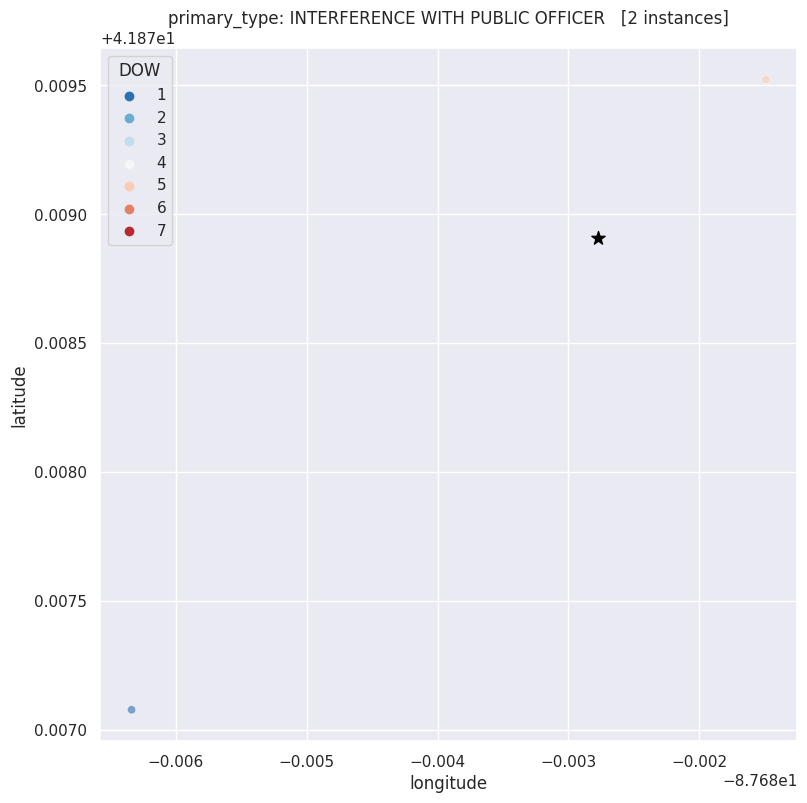

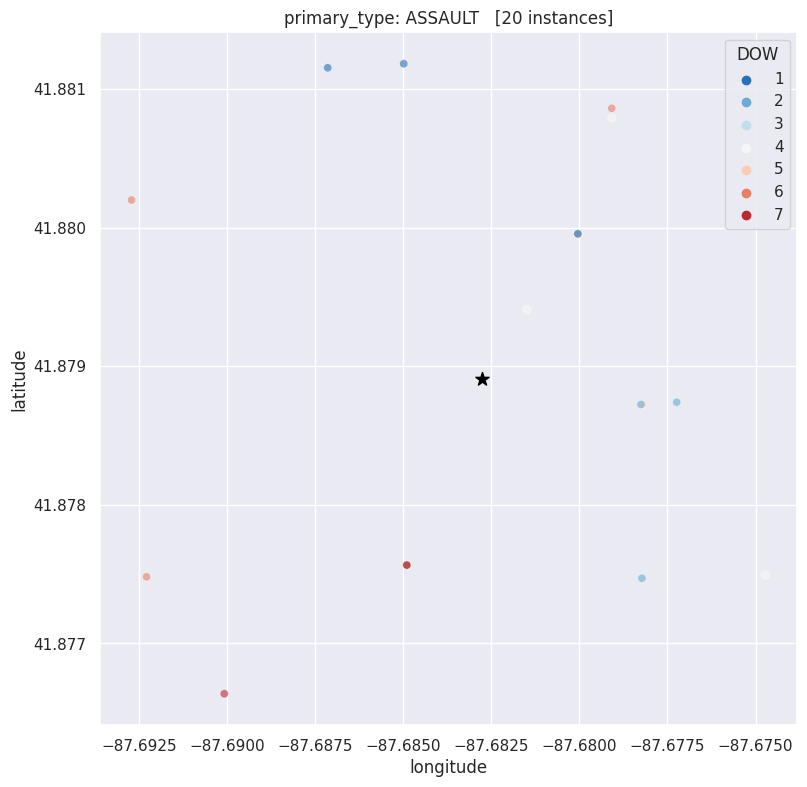

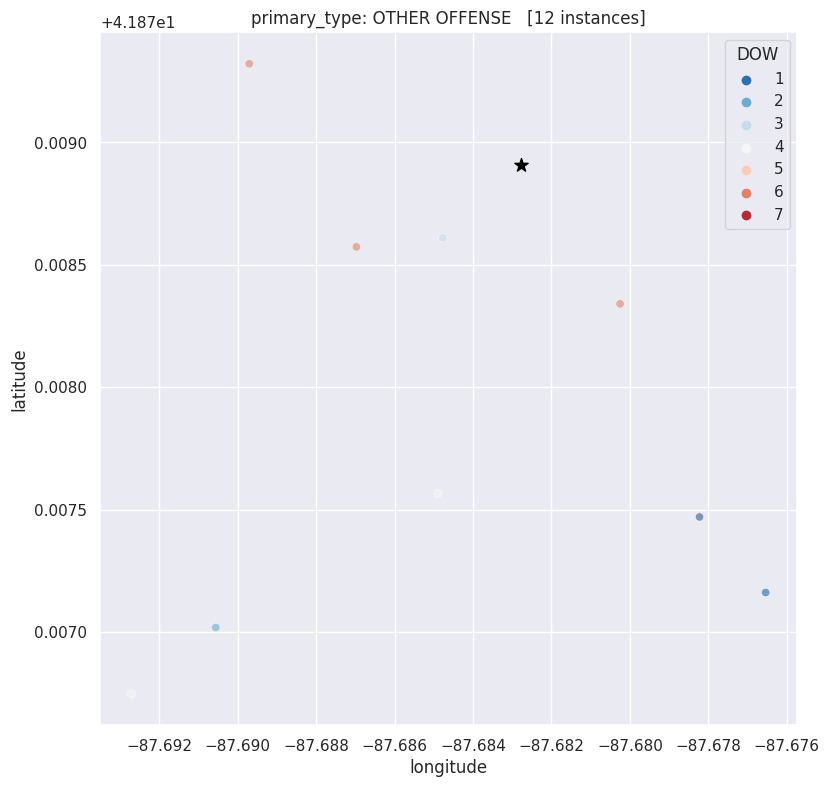

...

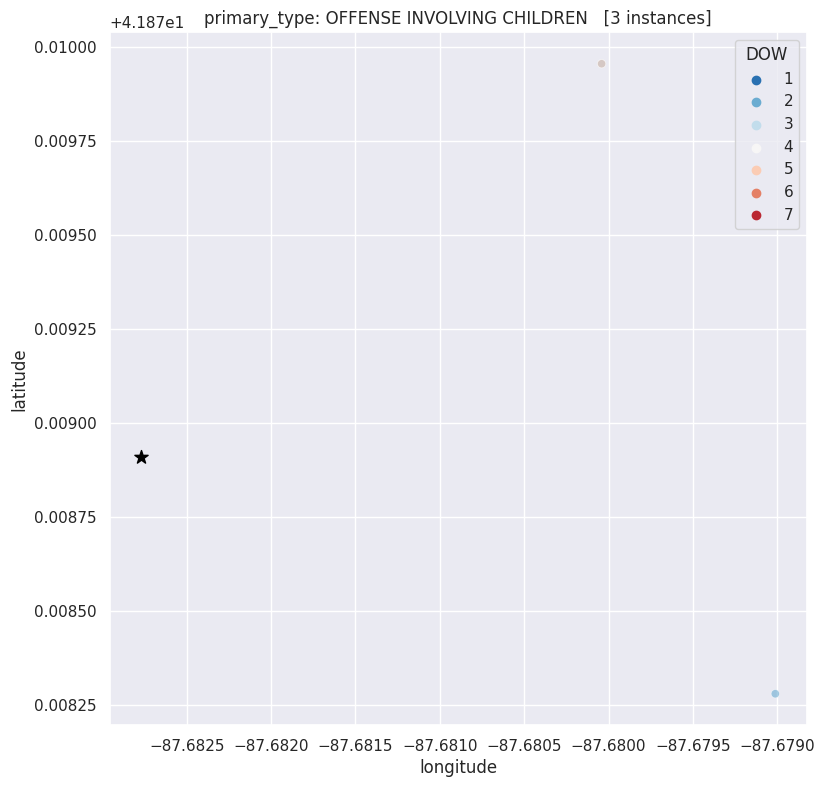

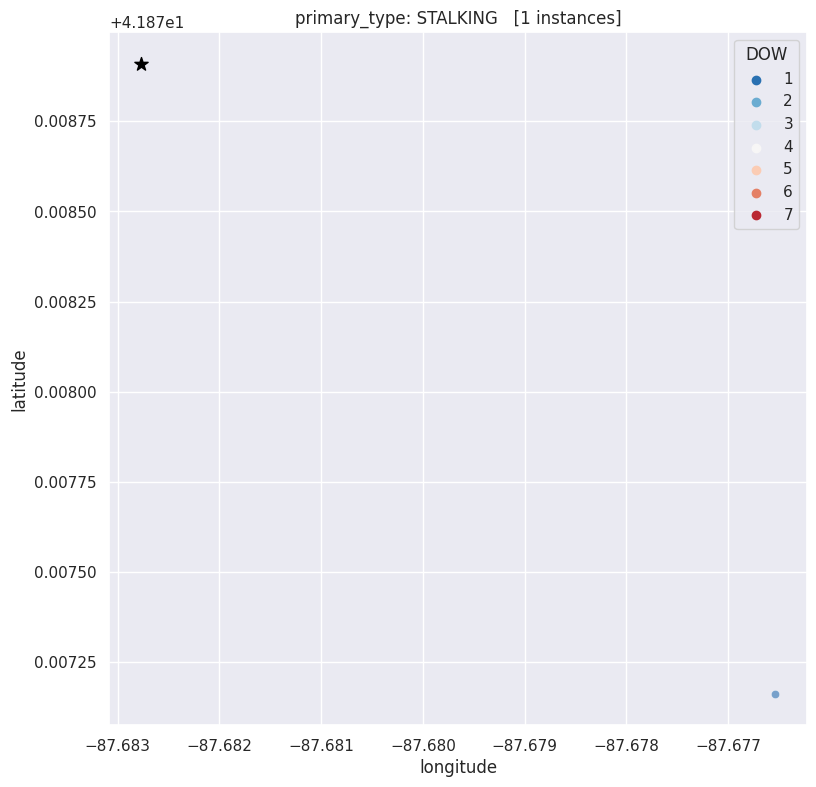

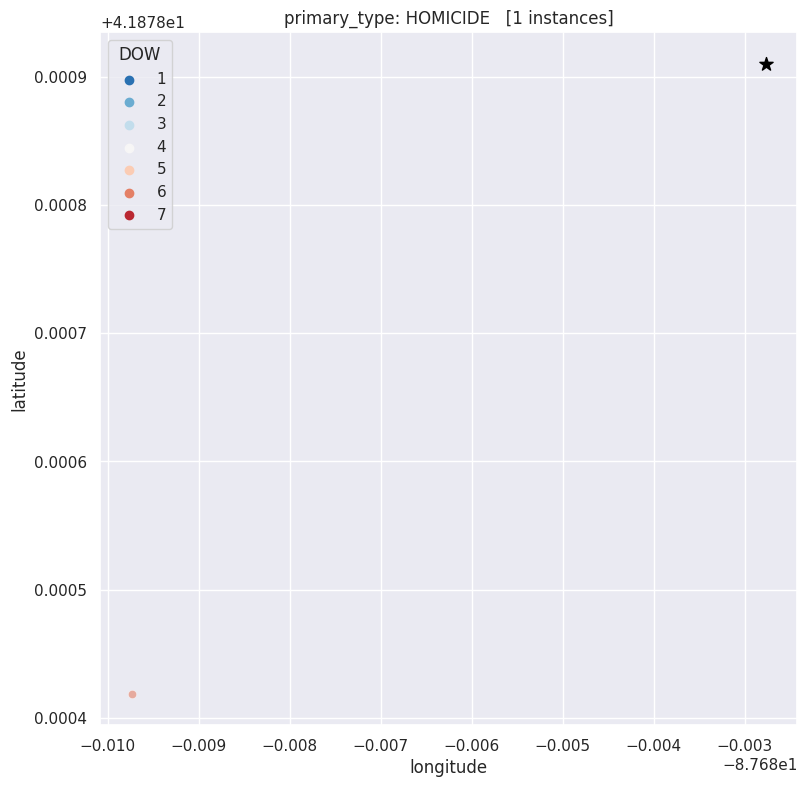

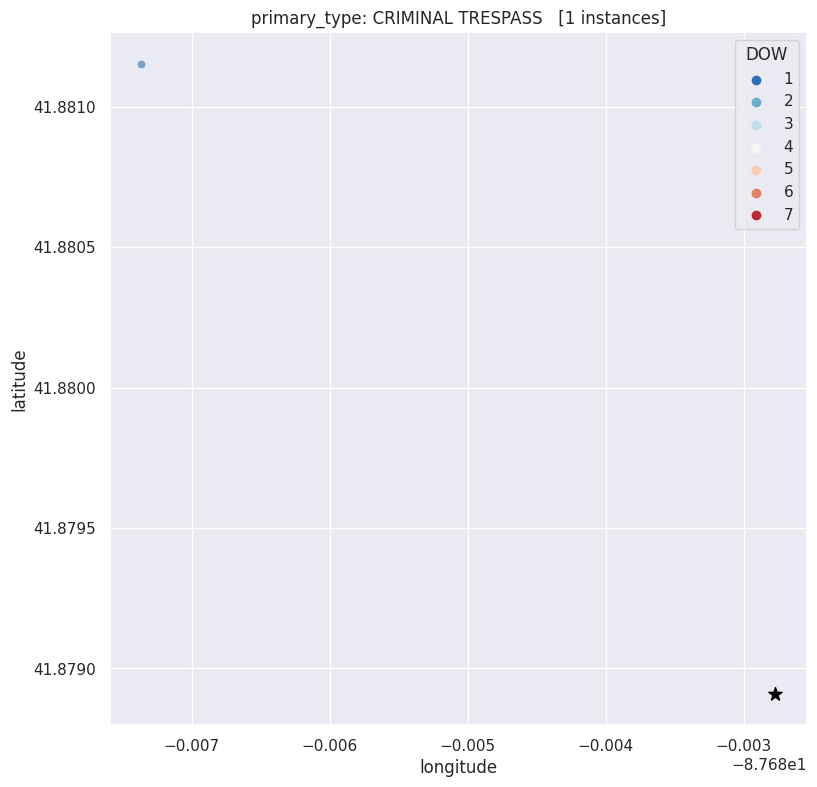

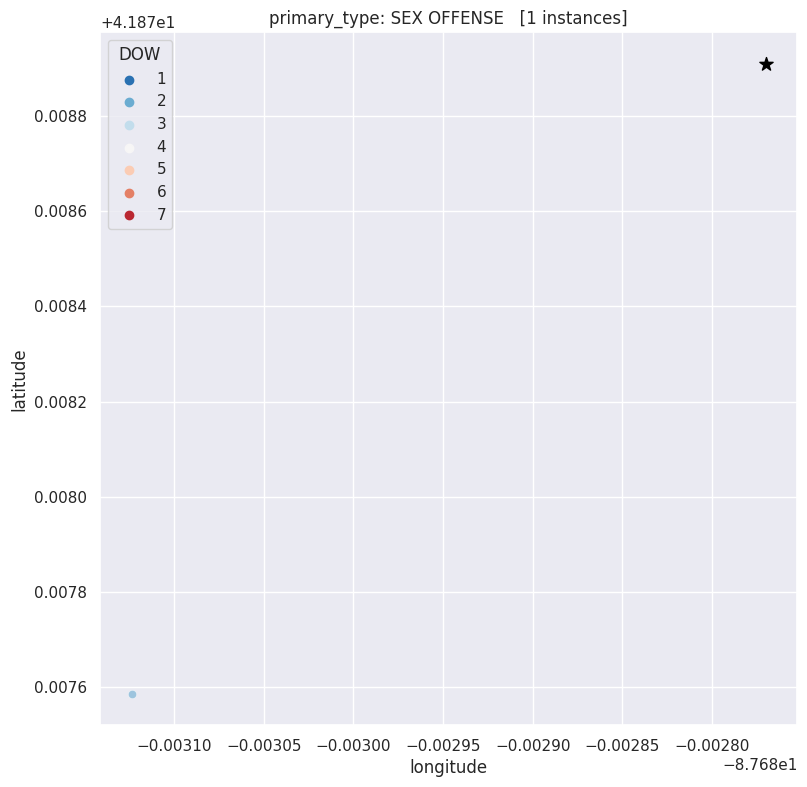

In [ ]:
# Plot crime location by values of Primary Type, and color points by DOW
scatterplotXYByCategory(newDF, 'longitude', 'latitude', 'primary_type', 'DOW', (Addr_Lat, Addr_Lon))

# Univariate Analysis

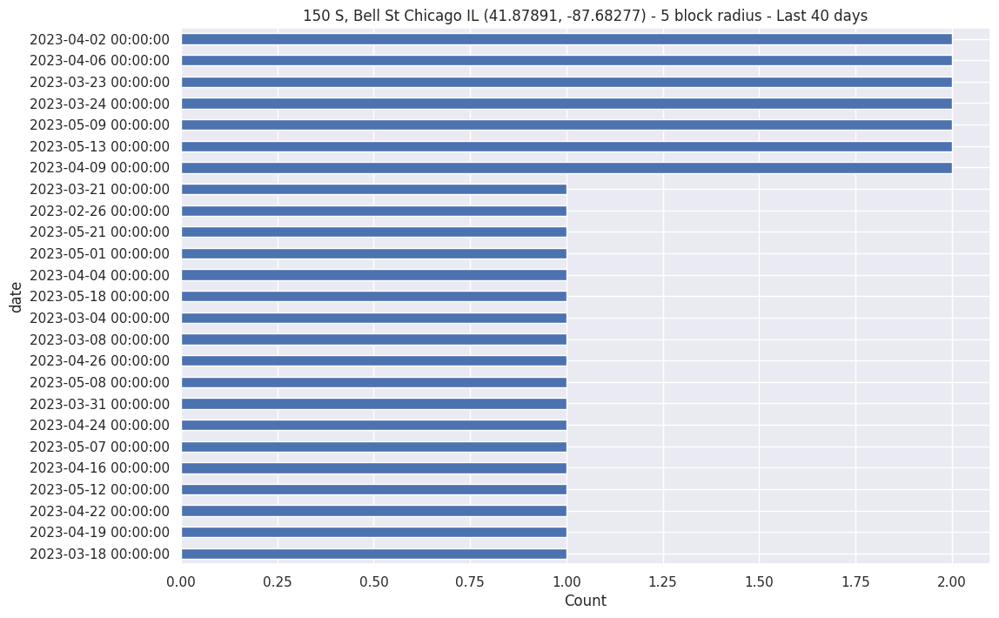

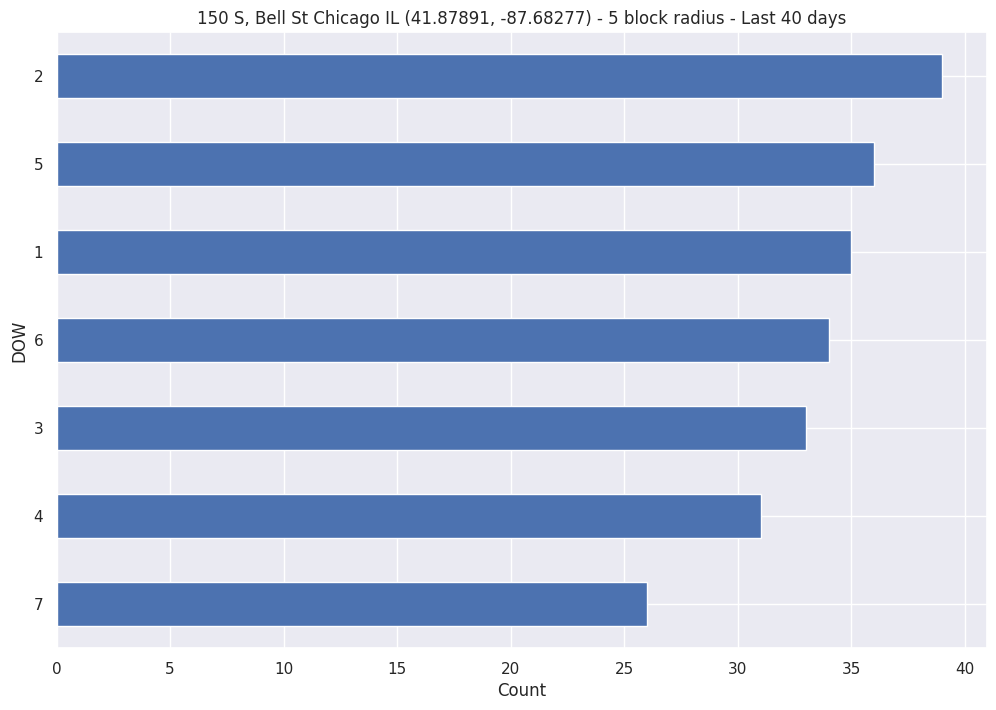

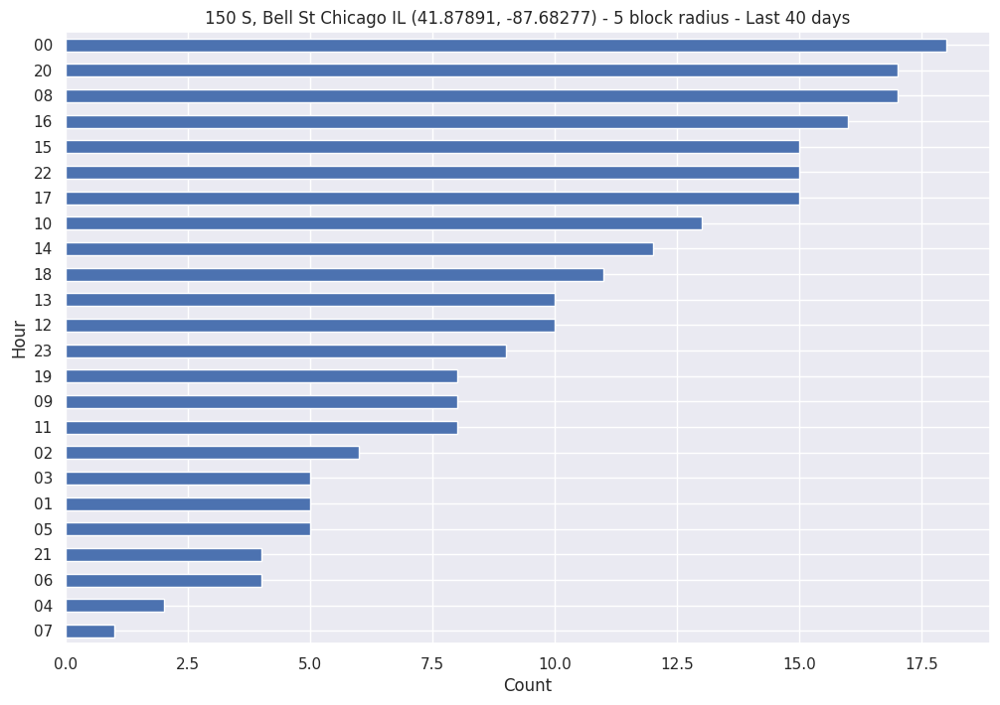

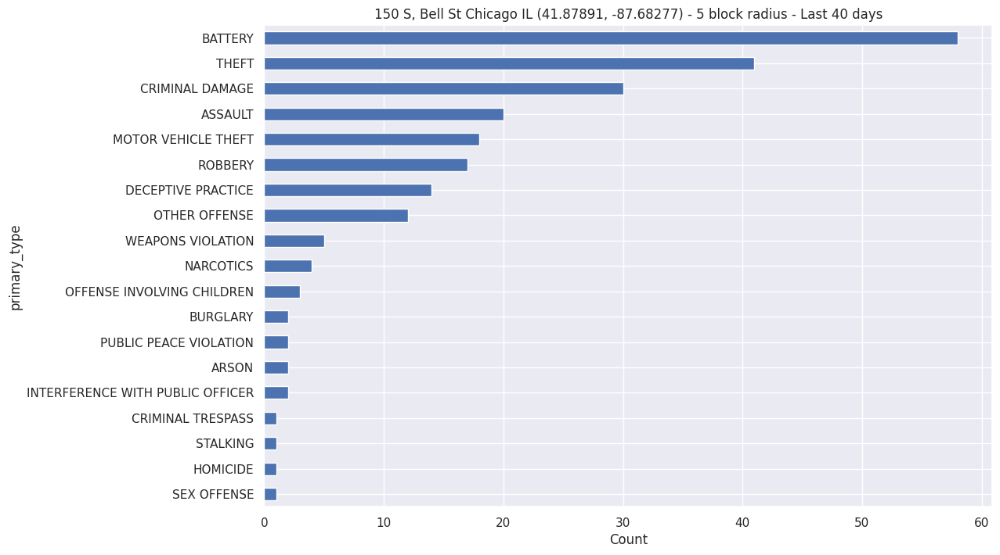

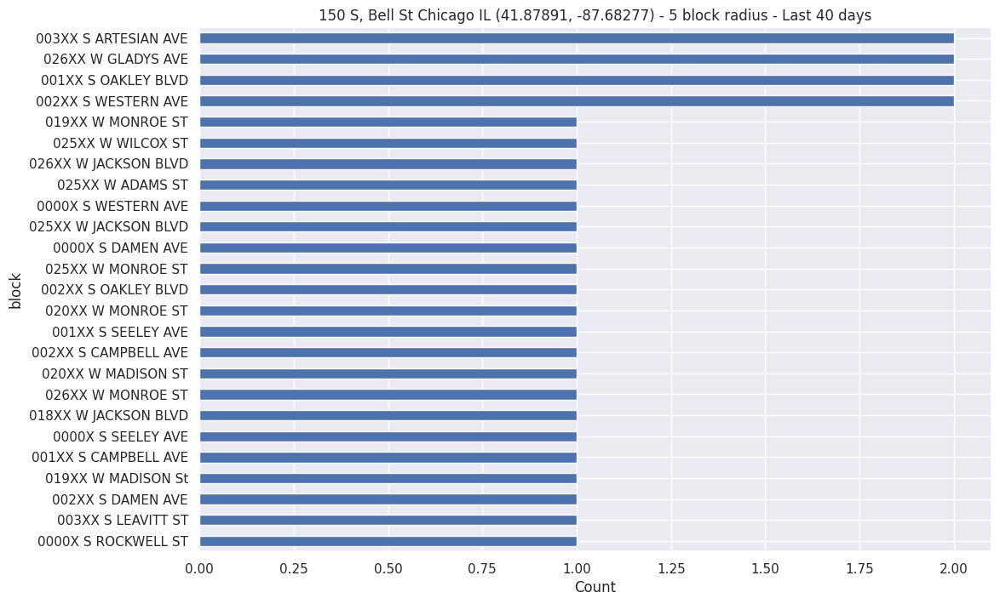

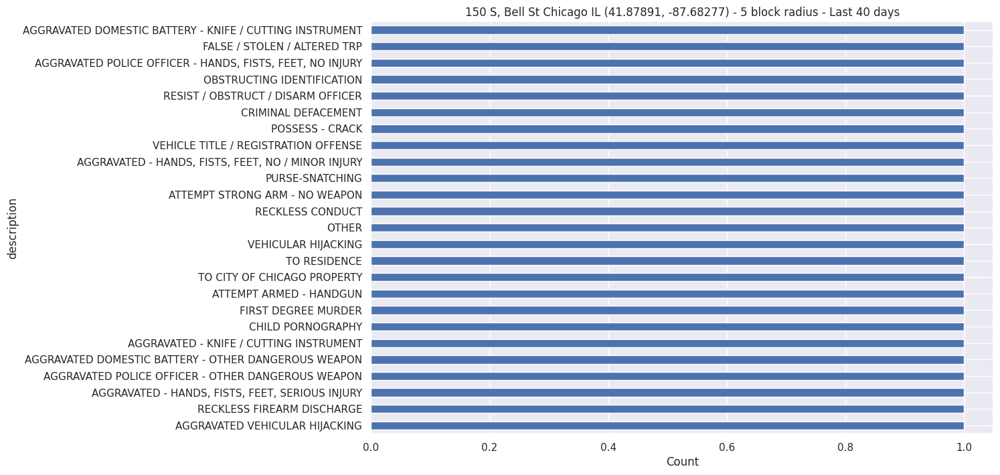

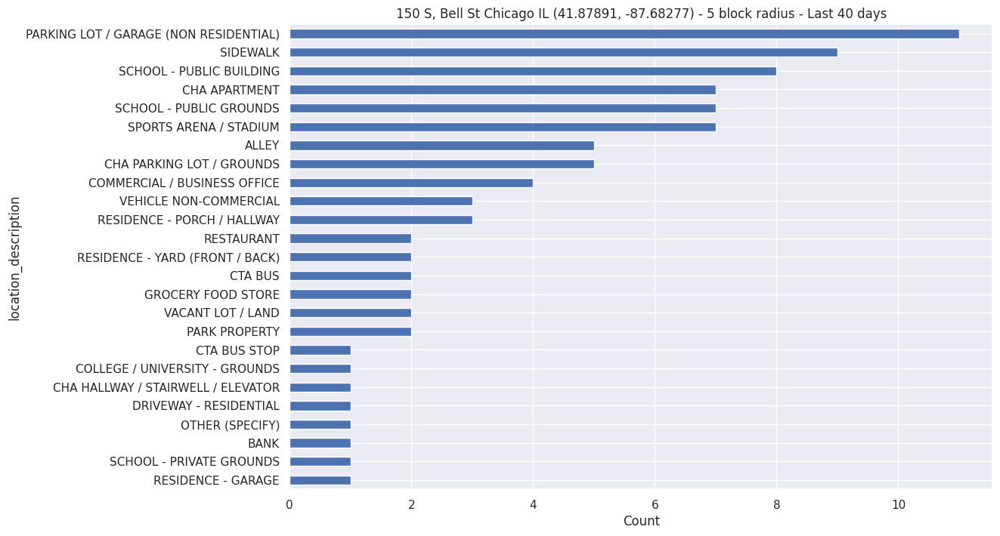

In [ ]:
# Plot counts for each categorical variable
catCols = ['date', 'DOW', 'Hour', 'primary_type', 'block', 'description', 
           'location_description']

for aCol in catCols:
  counts = newDF[aCol].value_counts(ascending=True)
  if len(counts) > 25:
    counts = counts[:25]
  plt.figure(figsize=(12, 8))
  counts.plot(kind='barh')
  plt.xlabel('Count')
  plt.ylabel(aCol)
  plt.title(Address_Comp)
  plt.savefig("drive/MyDrive/" + Address_Comp + "_" + aCol + "_Cnt.pdf")
  plt.show()

# Bi-variate Analysis


date  by  DOW
                   date DOW  cnt
0   2023-03-10 00:00:00   5    8
1   2023-03-07 00:00:00   2    6
2   2023-03-11 00:00:00   6    6
3   2023-02-27 00:00:00   1    5
4   2023-03-01 00:00:00   3    5
5   2023-03-03 00:00:00   5    5
6   2023-03-17 00:00:00   5    5
7   2023-03-28 00:00:00   2    5
8   2023-04-01 00:00:00   6    5
9   2023-04-10 00:00:00   1    5
10  2023-04-13 00:00:00   4    5
11  2023-04-25 00:00:00   2    5
12  2023-05-22 00:00:00   1    5
13  2023-02-24 00:00:00   5    4
14  2023-03-22 00:00:00   3    4
15  2023-03-25 00:00:00   6    4
16  2023-04-05 00:00:00   3    4
17  2023-04-07 00:00:00   5    4
18  2023-04-20 00:00:00   4    4
19  2023-05-06 00:00:00   6    4


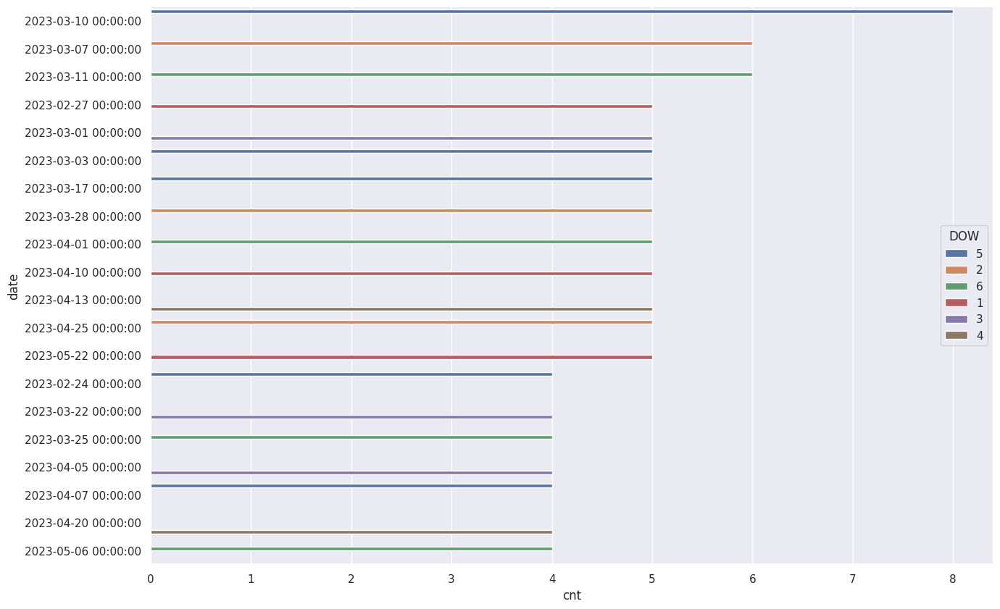


date  by  Hour
                   date Hour  cnt
0   2023-04-10 00:00:00   15    3
1   2023-02-27 00:00:00   23    2
2   2023-03-01 00:00:00   00    2
3   2023-03-07 00:00:00   11    2
4   2023-03-10 00:00:00   11    2
5   2023-03-10 00:00:00   17    2
6   2023-03-11 00:00:00   20    2
7   2023-04-01 00:00:00   22    2
8   2023-04-05 00:00:00   14    2
9   2023-04-13 00:00:00   13    2
10  2023-04-13 00:00:00   17    2
11  2023-04-25 00:00:00   19    2
12  2023-05-02 00:00:00   20    2
13  2023-05-17 00:00:00   17    2
14  2023-02-24 00:00:00   05    1
15  2023-02-24 00:00:00   12    1
16  2023-02-24 00:00:00   18    1
17  2023-02-24 00:00:00   20    1
18  2023-02-25 00:00:00   16    1
19  2023-02-25 00:00:00   20    1


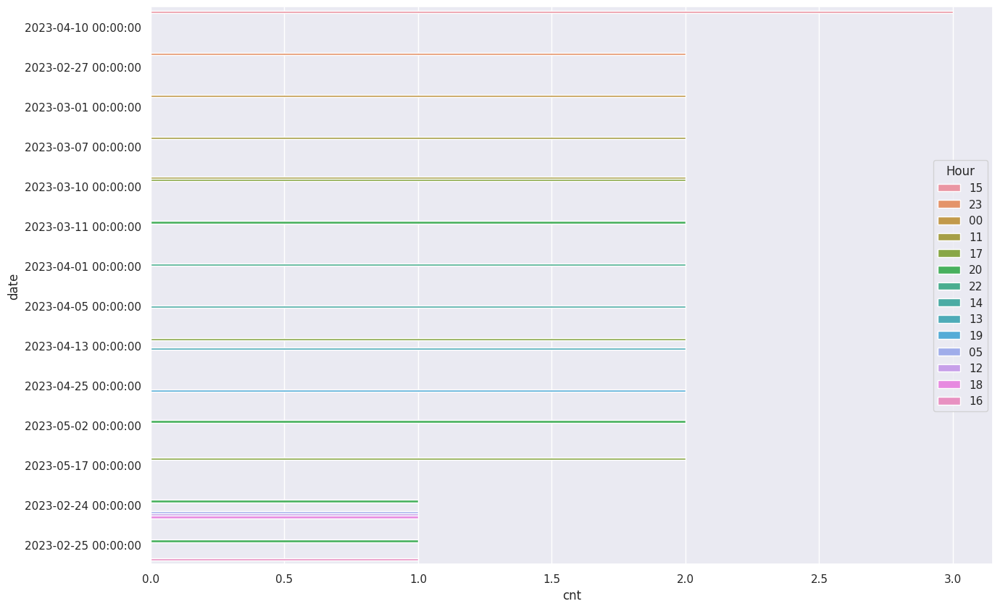


date  by  primary_type
                   date         primary_type  cnt
0   2023-04-13 00:00:00                THEFT    4
1   2023-02-27 00:00:00      CRIMINAL DAMAGE    3
2   2023-03-12 00:00:00              BATTERY    3
3   2023-03-28 00:00:00                THEFT    3
4   2023-04-01 00:00:00                THEFT    3
5   2023-04-10 00:00:00              BATTERY    3
6   2023-02-24 00:00:00                THEFT    2
7   2023-02-28 00:00:00              ASSAULT    2
8   2023-03-01 00:00:00   DECEPTIVE PRACTICE    2
9   2023-03-06 00:00:00      CRIMINAL DAMAGE    2
10  2023-03-07 00:00:00              BATTERY    2
11  2023-03-07 00:00:00                THEFT    2
12  2023-03-10 00:00:00   DECEPTIVE PRACTICE    2
13  2023-03-10 00:00:00                THEFT    2
14  2023-03-11 00:00:00  MOTOR VEHICLE THEFT    2
15  2023-03-16 00:00:00      CRIMINAL DAMAGE    2
16  2023-03-17 00:00:00              ROBBERY    2
17  2023-03-19 00:00:00      CRIMINAL DAMAGE    2
18  2023-03-22 00:00:00   

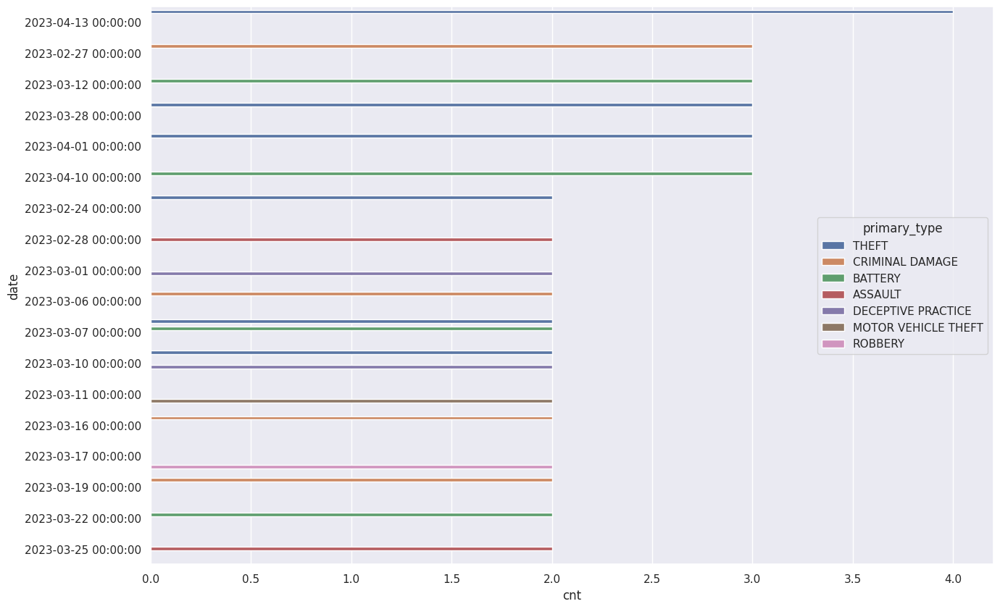


date  by  block
                   date                  block  cnt
0   2023-04-10 00:00:00     024XX W MADISON ST    3
1   2023-03-01 00:00:00    003XX S WESTERN AVE    2
2   2023-03-05 00:00:00     022XX W MADISON ST    2
3   2023-03-07 00:00:00   023XX W JACKSON BLVD    2
4   2023-03-10 00:00:00   003XX S ARTESIAN AVE    2
5   2023-03-15 00:00:00       023XX W ADAMS ST    2
6   2023-03-26 00:00:00  003XX S MAPLEWOOD AVE    2
7   2023-03-29 00:00:00   020XX W JACKSON BLVD    2
8   2023-04-10 00:00:00      003XX S DAMEN AVE    2
9   2023-04-20 00:00:00   022XX W JACKSON BLVD    2
10  2023-04-25 00:00:00   020XX W JACKSON BLVD    2
11  2023-05-15 00:00:00     023XX W MADISON ST    2
12  2023-02-24 00:00:00     001XX S LEAVITT ST    1
13  2023-02-24 00:00:00    001XX S OAKLEY BLVD    1
14  2023-02-24 00:00:00     019XX W MADISON ST    1
15  2023-02-24 00:00:00     023XX W MADISON ST    1
16  2023-02-25 00:00:00      025XX W WILCOX ST    1
17  2023-02-25 00:00:00   026XX W JACKSON BLVD 

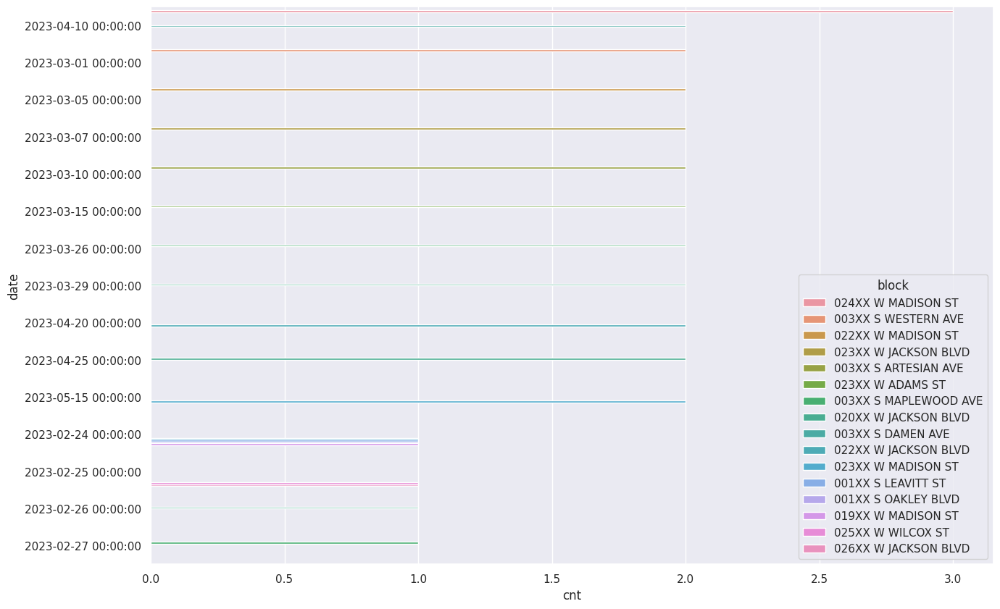


date  by  description
                   date                          description  cnt
0   2023-04-10 00:00:00                               SIMPLE    3
1   2023-02-24 00:00:00                            OVER $500    2
2   2023-02-27 00:00:00                          TO PROPERTY    2
3   2023-02-28 00:00:00                               SIMPLE    2
4   2023-03-02 00:00:00                               SIMPLE    2
5   2023-03-07 00:00:00                       $500 AND UNDER    2
6   2023-03-07 00:00:00                               SIMPLE    2
7   2023-03-11 00:00:00                           AUTOMOBILE    2
8   2023-03-12 00:00:00                               SIMPLE    2
9   2023-03-14 00:00:00                               SIMPLE    2
10  2023-03-16 00:00:00                           TO VEHICLE    2
11  2023-03-19 00:00:00                          TO PROPERTY    2
12  2023-03-22 00:00:00                               SIMPLE    2
13  2023-03-25 00:00:00  AGGRAVATED - OTHER DANGEROUS

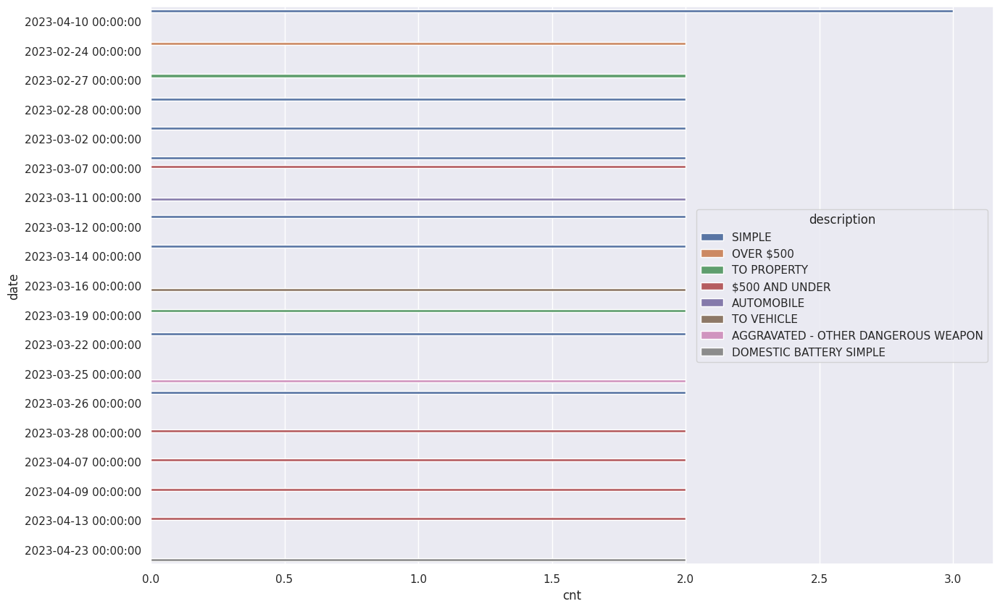


date  by  location_description
                   date          location_description  cnt
0   2023-04-13 00:00:00                        STREET    4
1   2023-03-03 00:00:00                        STREET    3
2   2023-03-11 00:00:00                        STREET    3
3   2023-03-12 00:00:00                     APARTMENT    3
4   2023-03-16 00:00:00                        STREET    3
5   2023-03-17 00:00:00                        STREET    3
6   2023-04-10 00:00:00  COMMERCIAL / BUSINESS OFFICE    3
7   2023-04-14 00:00:00                        STREET    3
8   2023-05-17 00:00:00                        STREET    3
9   2023-05-24 00:00:00                        STREET    3
10  2023-03-01 00:00:00                     RESIDENCE    2
11  2023-03-01 00:00:00                        STREET    2
12  2023-03-05 00:00:00                        STREET    2
13  2023-03-06 00:00:00                        STREET    2
14  2023-03-07 00:00:00                     APARTMENT    2
15  2023-03-07 00:00:00 

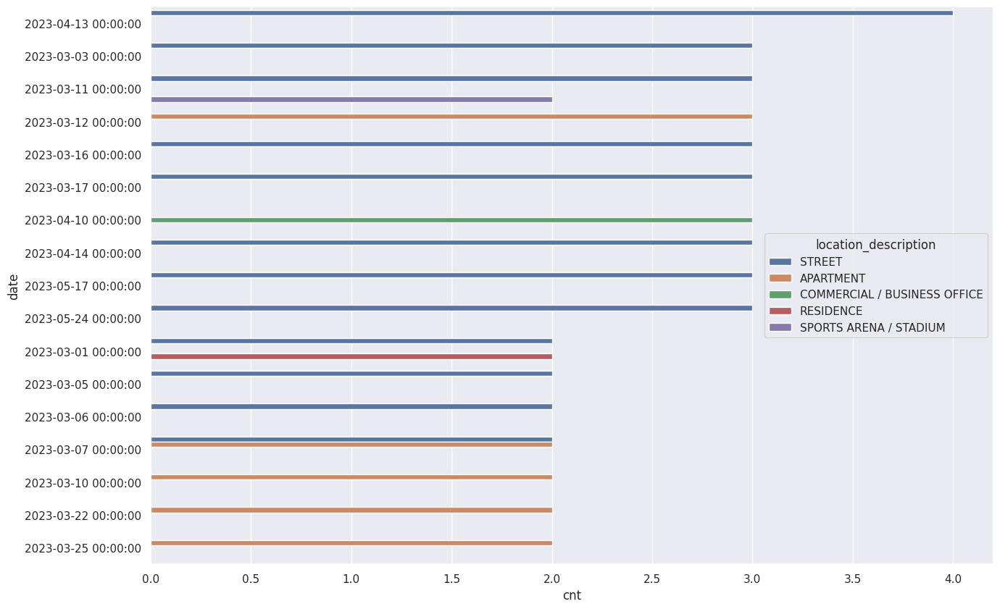


DOW  by  Hour
   DOW Hour  cnt
0    3   00    6
1    1   15    5
2    5   12    5
3    1   22    4
4    2   08    4
5    2   14    4
6    2   16    4
7    2   19    4
8    2   22    4
9    3   13    4
10   4   17    4
11   6   00    4
12   6   15    4
13   6   20    4
14   7   08    4
15   1   08    3
16   1   09    3
17   1   17    3
18   1   20    3
19   1   23    3


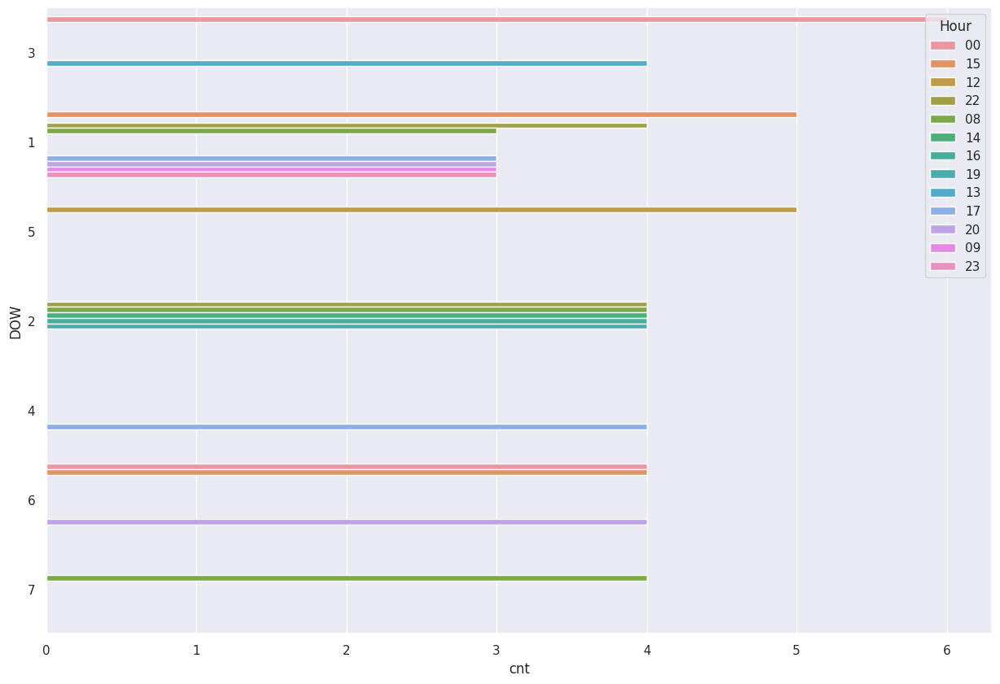


DOW  by  primary_type
   DOW         primary_type  cnt
0    3              BATTERY   12
1    7              BATTERY   11
2    6              BATTERY    9
3    1              BATTERY    8
4    2              BATTERY    8
5    4      CRIMINAL DAMAGE    8
6    5                THEFT    8
7    1      CRIMINAL DAMAGE    7
8    2                THEFT    7
9    3   DECEPTIVE PRACTICE    7
10   4                THEFT    7
11   2              ROBBERY    6
12   6                THEFT    6
13   1                THEFT    5
14   2              ASSAULT    5
15   4              BATTERY    5
16   5              BATTERY    5
17   5  MOTOR VEHICLE THEFT    5
18   5              ROBBERY    5
19   7                THEFT    5


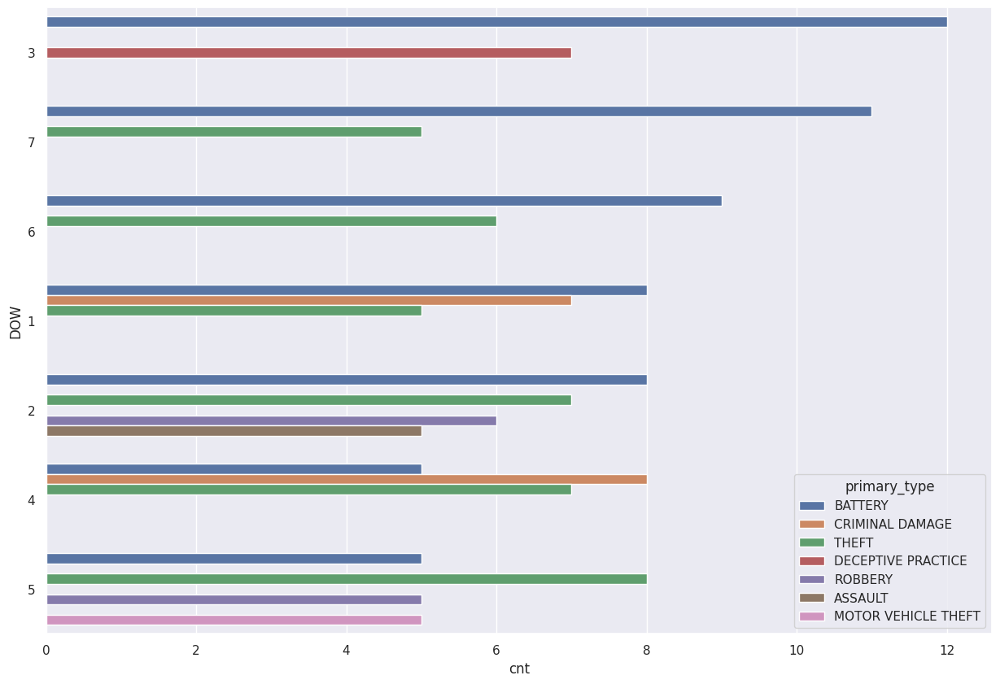


DOW  by  block
   DOW                 block  cnt
0    1    024XX W MADISON ST    7
1    3  020XX W JACKSON BLVD    5
2    4  022XX W JACKSON BLVD    5
3    5  020XX W JACKSON BLVD    5
4    2      020XX W ADAMS ST    4
5    2  022XX W JACKSON BLVD    4
6    5  023XX W JACKSON BLVD    4
7    6  020XX W JACKSON BLVD    4
8    7  023XX W JACKSON BLVD    4
9    1   003XX S WESTERN AVE    3
10   1  020XX W JACKSON BLVD    3
11   1    023XX W MADISON ST    3
12   2  023XX W JACKSON BLVD    3
13   3  003XX S CAMPBELL AVE    3
14   5    019XX W MADISON ST    3
15   5      020XX W ADAMS ST    3
16   6  023XX W JACKSON BLVD    3
17   6    025XX W MADISON ST    3
18   1     003XX S DAMEN AVE    2
19   1      020XX W ADAMS ST    2


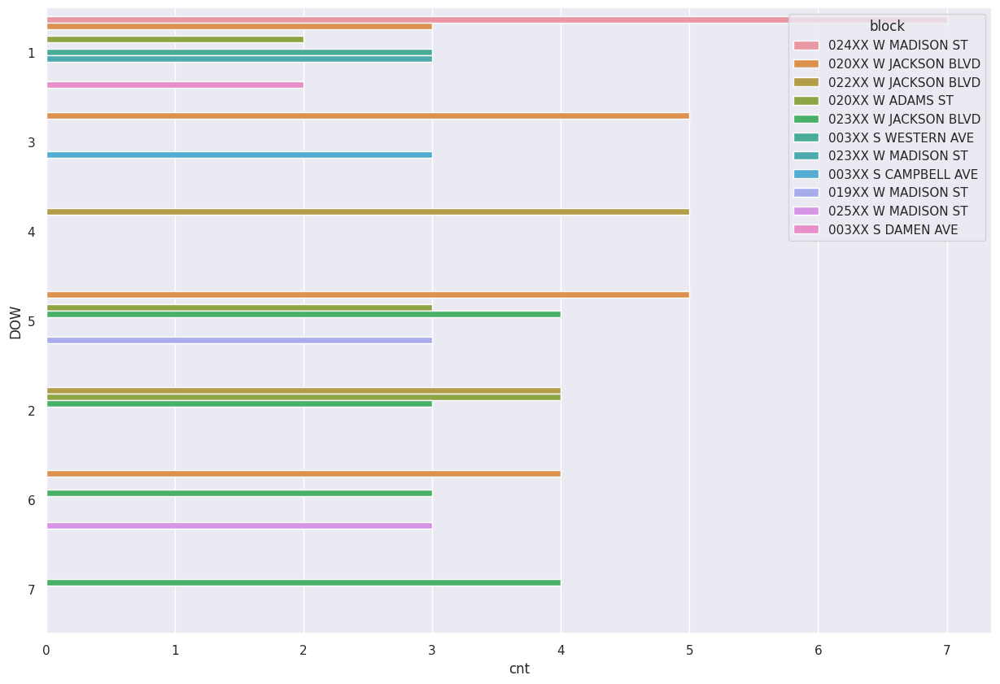


DOW  by  description
   DOW              description  cnt
0    2                   SIMPLE   11
1    1                   SIMPLE    8
2    7                   SIMPLE    8
3    3                   SIMPLE    6
4    2           $500 AND UNDER    5
5    4               TO VEHICLE    5
6    5               AUTOMOBILE    5
7    5                OVER $500    5
8    5                   SIMPLE    5
9    6  DOMESTIC BATTERY SIMPLE    5
10   1           $500 AND UNDER    4
11   4                   SIMPLE    4
12   7  DOMESTIC BATTERY SIMPLE    4
13   1              TO PROPERTY    3
14   1               TO VEHICLE    3
15   2               AUTOMOBILE    3
16   3  DOMESTIC BATTERY SIMPLE    3
17   3               TO VEHICLE    3
18   4           $500 AND UNDER    3
19   4              TO PROPERTY    3


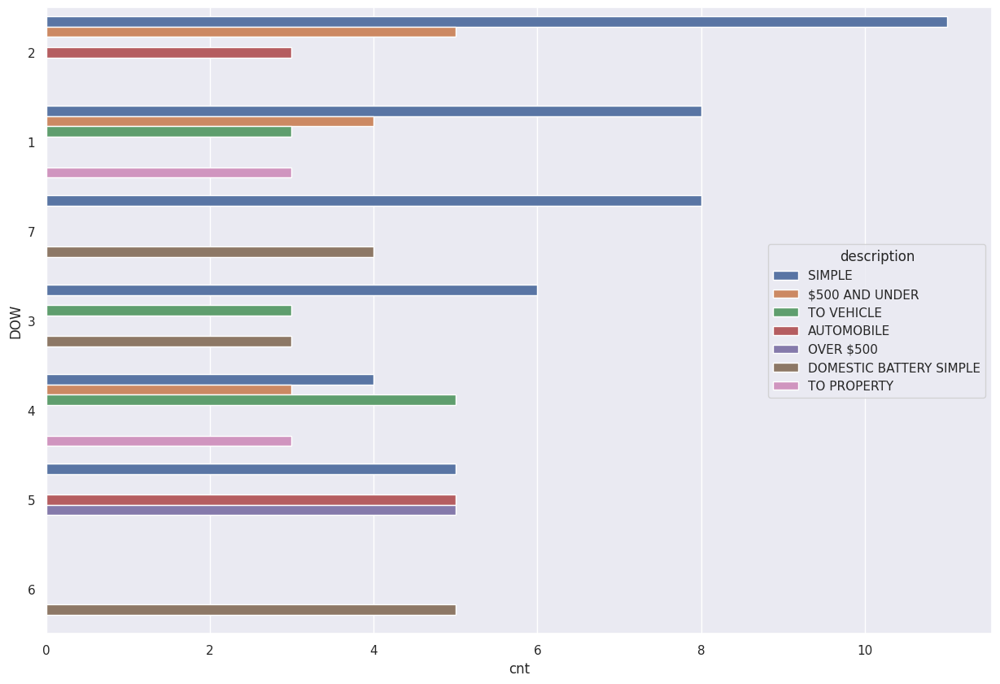


DOW  by  location_description
   DOW                    location_description  cnt
0    5                                  STREET   15
1    4                                  STREET   14
2    2                               APARTMENT   12
3    3                                  STREET   12
4    2                                  STREET   11
5    7                               APARTMENT   11
6    1                                  STREET   10
7    6                                  STREET   10
8    6                               APARTMENT    8
9    7                                  STREET    8
10   3                               APARTMENT    7
11   5                               APARTMENT    7
12   3                               RESIDENCE    5
13   6  PARKING LOT / GARAGE (NON RESIDENTIAL)    5
14   1                               APARTMENT    4
15   4                               APARTMENT    4
16   1            COMMERCIAL / BUSINESS OFFICE    3
17   2                SCHOOL - PU

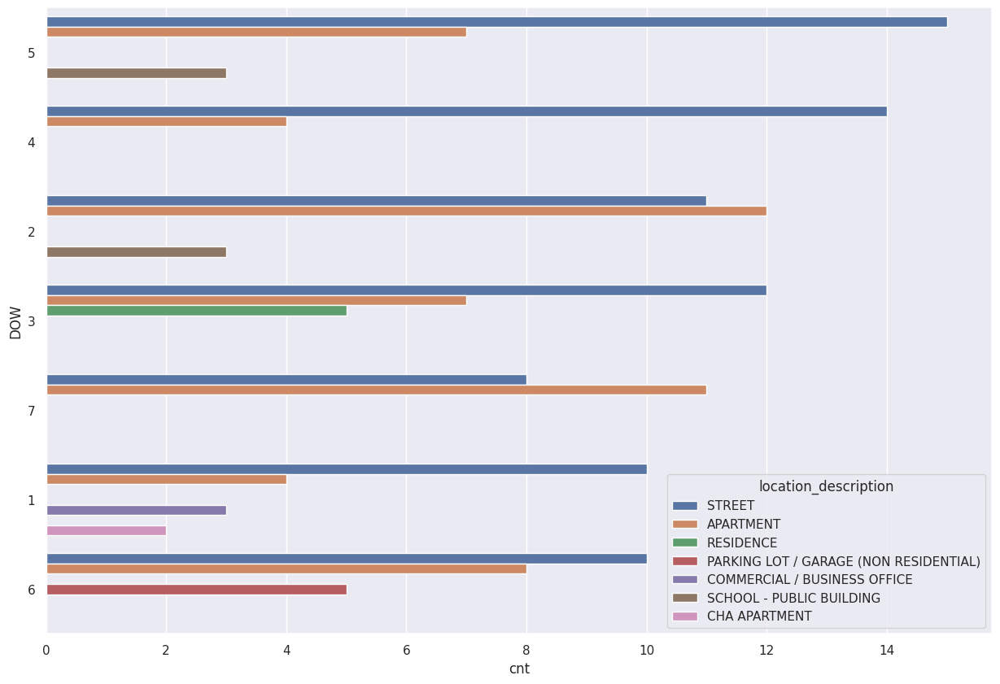


Hour  by  primary_type
   Hour         primary_type  cnt
0    08              BATTERY    7
1    16              BATTERY    7
2    00              BATTERY    5
3    13                THEFT    5
4    14              BATTERY    5
5    15              BATTERY    5
6    17                THEFT    5
7    22      CRIMINAL DAMAGE    5
8    00      CRIMINAL DAMAGE    4
9    08                THEFT    4
10   10              BATTERY    4
11   18              BATTERY    4
12   20  MOTOR VEHICLE THEFT    4
13   00   DECEPTIVE PRACTICE    3
14   09                THEFT    3
15   10                THEFT    3
16   11              BATTERY    3
17   13              BATTERY    3
18   15      CRIMINAL DAMAGE    3
19   15                THEFT    3


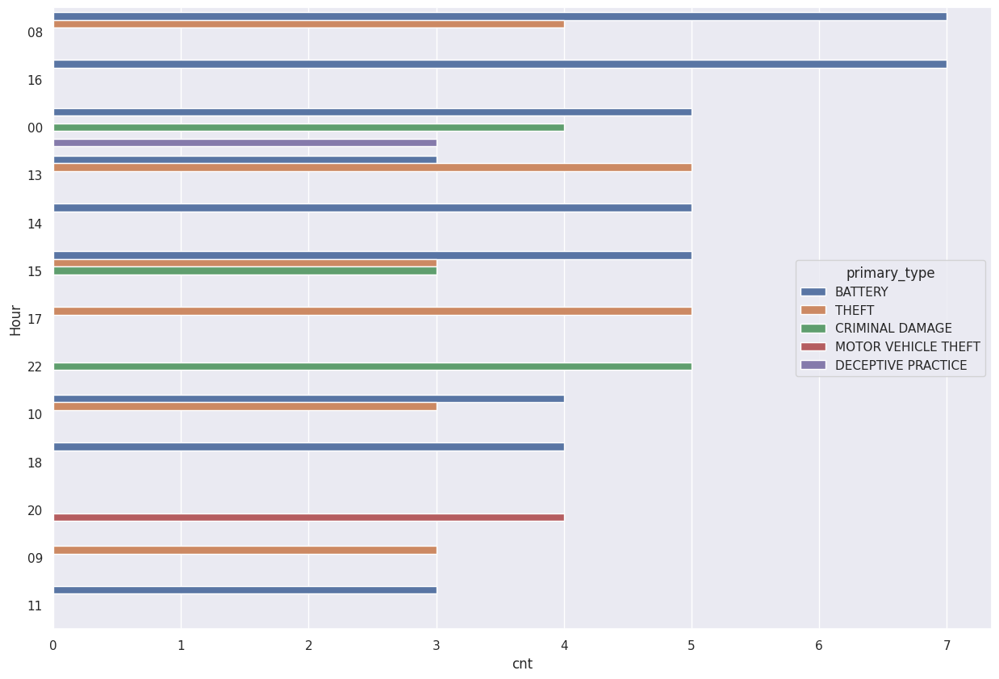


Hour  by  block
   Hour                 block  cnt
0    02  020XX W JACKSON BLVD    4
1    00   003XX S WESTERN AVE    3
2    08  003XX S CAMPBELL AVE    3
3    08      020XX W ADAMS ST    3
4    13     021XX W MONROE ST    3
5    15    024XX W MADISON ST    3
6    17  023XX W JACKSON BLVD    3
7    22    019XX W MADISON ST    3
8    00  020XX W JACKSON BLVD    2
9    00  022XX W JACKSON BLVD    2
10   00  023XX W JACKSON BLVD    2
11   00    026XX W GLADYS AVE    2
12   01  023XX W JACKSON BLVD    2
13   08    023XX W MADISON ST    2
14   09     003XX S DAMEN AVE    2
15   10  020XX W JACKSON BLVD    2
16   10     021XX W MONROE ST    2
17   10  023XX W JACKSON BLVD    2
18   11  003XX S ARTESIAN AVE    2
19   12      020XX W ADAMS ST    2


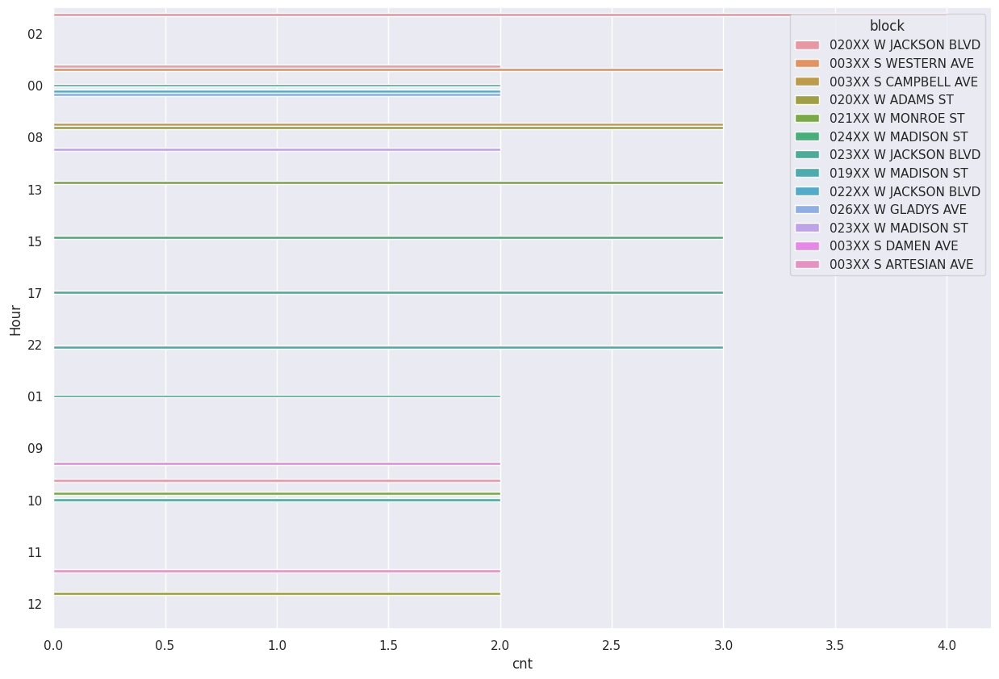


Hour  by  description
   Hour              description  cnt
0    08                   SIMPLE    6
1    14                   SIMPLE    5
2    10                   SIMPLE    4
3    15                   SIMPLE    4
4    18                   SIMPLE    4
5    20               AUTOMOBILE    4
6    00               TO VEHICLE    3
7    11                   SIMPLE    3
8    15           $500 AND UNDER    3
9    16  DOMESTIC BATTERY SIMPLE    3
10   17                OVER $500    3
11   20               TO VEHICLE    3
12   22              TO PROPERTY    3
13   00  DOMESTIC BATTERY SIMPLE    2
14   00                OVER $500    2
15   00                   SIMPLE    2
16   08           $500 AND UNDER    2
17   08  DOMESTIC BATTERY SIMPLE    2
18   09           $500 AND UNDER    2
19   09                   SIMPLE    2


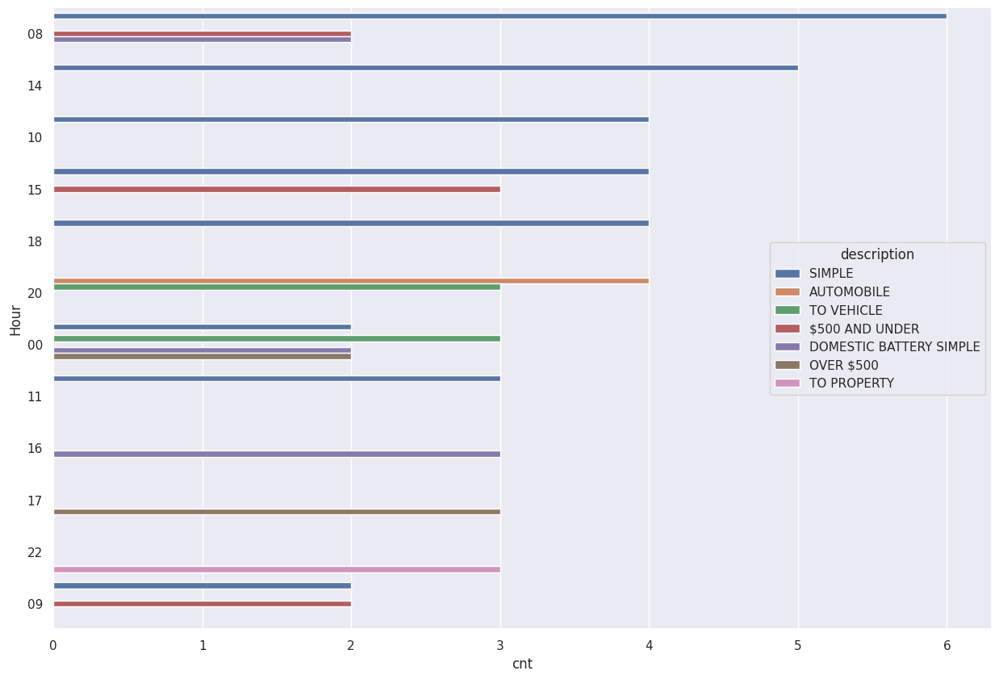


Hour  by  location_description
   Hour location_description  cnt
0    20               STREET    8
1    00            APARTMENT    7
2    00               STREET    7
3    16               STREET    7
4    08            APARTMENT    6
5    17               STREET    6
6    10               STREET    5
7    22               STREET    5
8    15            APARTMENT    4
9    18               STREET    4
10   19               STREET    4
11   01               STREET    3
12   02            APARTMENT    3
13   02               STREET    3
14   03               STREET    3
15   05            APARTMENT    3
16   06               STREET    3
17   08               STREET    3
18   09            APARTMENT    3
19   09               STREET    3


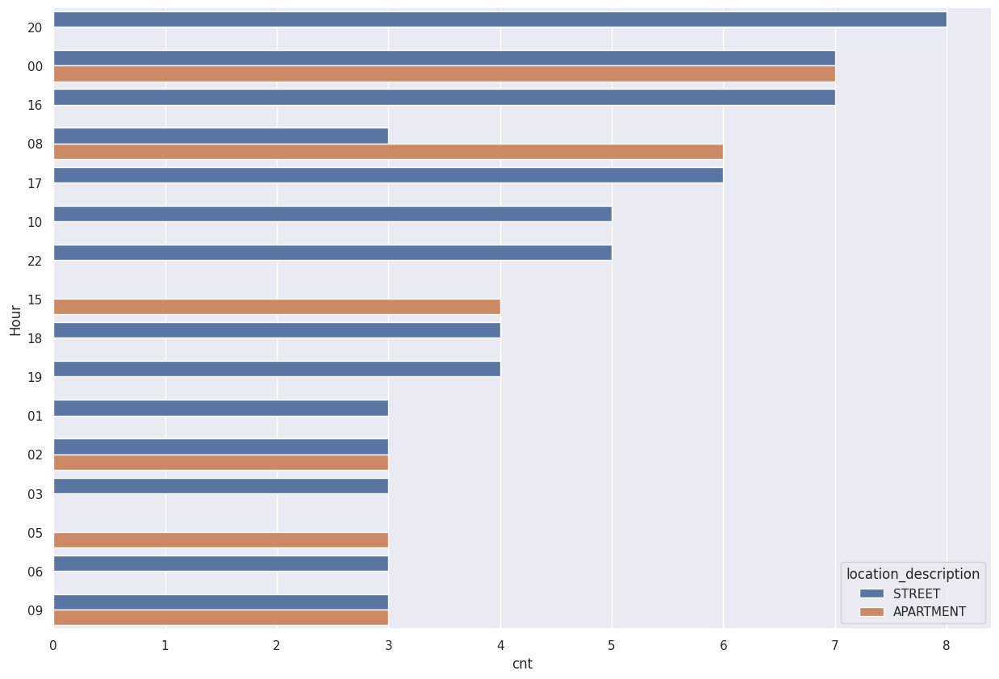


primary_type  by  block
          primary_type                 block  cnt
0              BATTERY  020XX W JACKSON BLVD    8
1              BATTERY  023XX W JACKSON BLVD    8
2                THEFT    023XX W MADISON ST    6
3              BATTERY    024XX W MADISON ST    5
4              ASSAULT  023XX W JACKSON BLVD    4
5              BATTERY  003XX S CAMPBELL AVE    4
6      CRIMINAL DAMAGE  022XX W JACKSON BLVD    4
7   DECEPTIVE PRACTICE    019XX W MADISON ST    4
8                THEFT  022XX W JACKSON BLVD    4
9              ASSAULT      020XX W ADAMS ST    3
10             ASSAULT     021XX W MONROE ST    3
11             BATTERY      020XX W ADAMS ST    3
12             BATTERY     021XX W MONROE ST    3
13     CRIMINAL DAMAGE     023XX W MONROE ST    3
14       OTHER OFFENSE  020XX W JACKSON BLVD    3
15               THEFT     003XX S DAMEN AVE    3
16             ASSAULT     0000X S HOYNE AVE    2
17             BATTERY     0000X S HOYNE AVE    2
18             BATTERY   

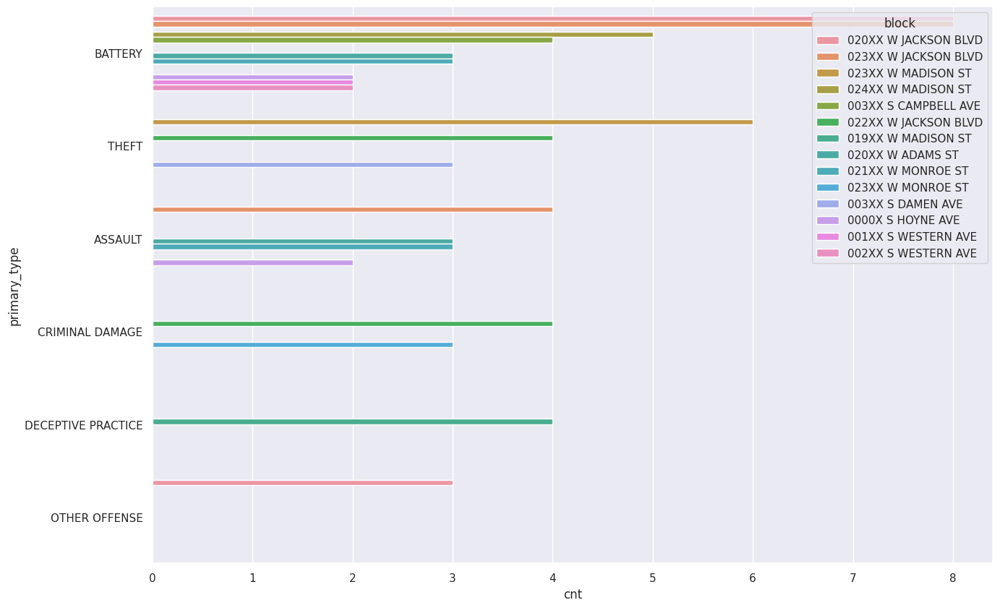


primary_type  by  description
           primary_type                          description  cnt
0               BATTERY                               SIMPLE   29
1               BATTERY              DOMESTIC BATTERY SIMPLE   18
2                 THEFT                       $500 AND UNDER   18
3       CRIMINAL DAMAGE                           TO VEHICLE   17
4   MOTOR VEHICLE THEFT                           AUTOMOBILE   16
5                 THEFT                            OVER $500   15
6               ASSAULT                               SIMPLE   14
7       CRIMINAL DAMAGE                          TO PROPERTY   11
8               ROBBERY                      ARMED - HANDGUN    7
9               ROBBERY               STRONG ARM - NO WEAPON    6
10                THEFT                        FROM BUILDING    5
11              BATTERY  AGGRAVATED - OTHER DANGEROUS WEAPON    4
12    WEAPONS VIOLATION        UNLAWFUL POSSESSION - HANDGUN    4
13   DECEPTIVE PRACTICE                    CR

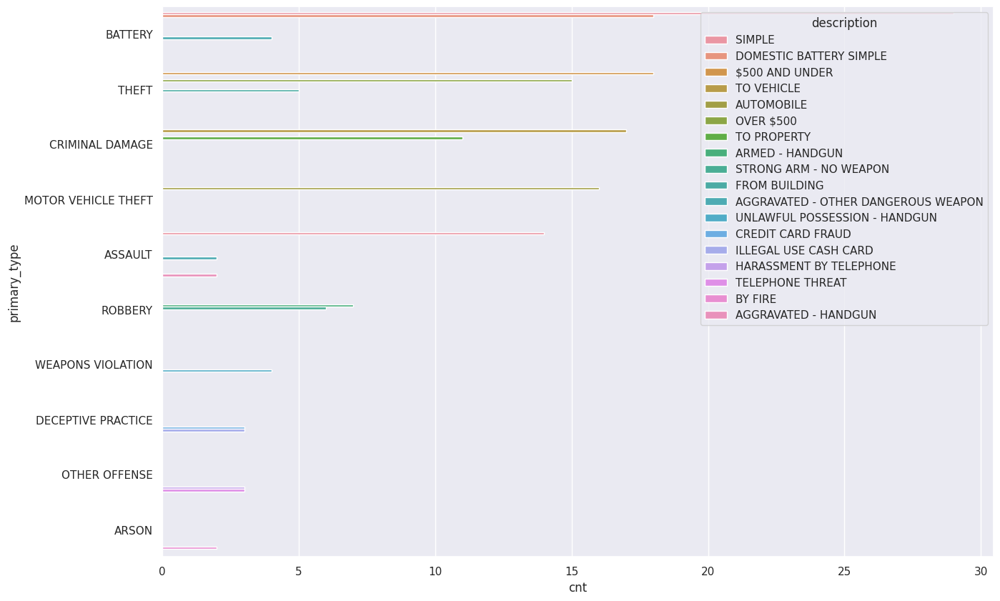


primary_type  by  location_description
           primary_type          location_description  cnt
0               BATTERY                     APARTMENT   20
1                 THEFT                        STREET   17
2   MOTOR VEHICLE THEFT                        STREET   16
3       CRIMINAL DAMAGE                        STREET   15
4               BATTERY                        STREET   12
5               ROBBERY                        STREET   10
6       CRIMINAL DAMAGE                     APARTMENT    8
7                 THEFT                     APARTMENT    7
8               ASSAULT                     APARTMENT    6
9         OTHER OFFENSE                     APARTMENT    6
10   DECEPTIVE PRACTICE                     APARTMENT    5
11   DECEPTIVE PRACTICE        SPORTS ARENA / STADIUM    4
12              BATTERY  COMMERCIAL / BUSINESS OFFICE    3
13              BATTERY                     RESIDENCE    3
14              BATTERY       SCHOOL - PUBLIC GROUNDS    3
15   DECEPTIVE P

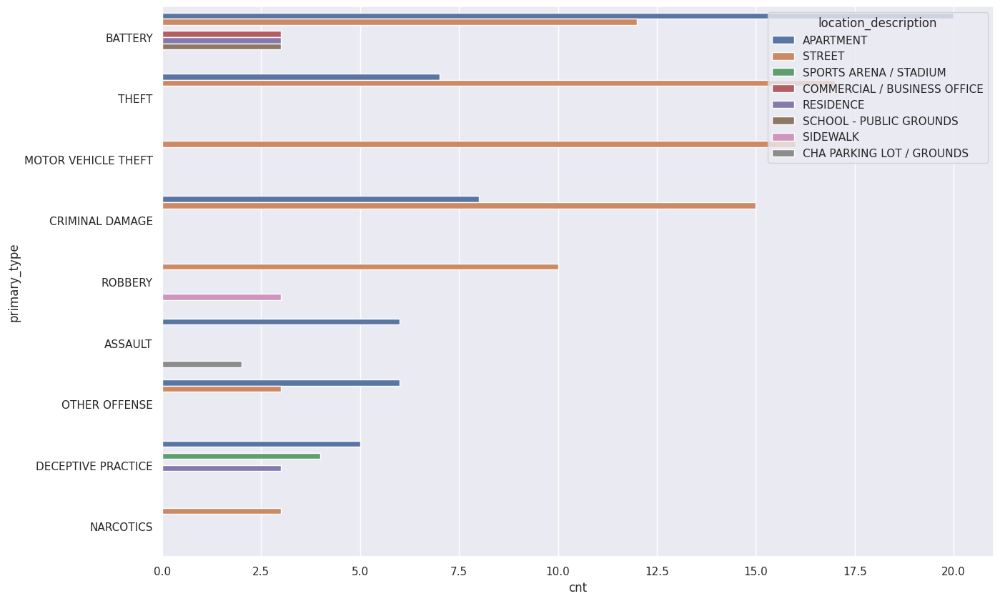


block  by  description
                    block                          description  cnt
0    020XX W JACKSON BLVD                               SIMPLE    6
1    023XX W JACKSON BLVD              DOMESTIC BATTERY SIMPLE    6
2       021XX W MONROE ST                               SIMPLE    5
3    023XX W JACKSON BLVD                               SIMPLE    5
4        020XX W ADAMS ST                               SIMPLE    4
5      024XX W MADISON ST                               SIMPLE    4
6       003XX S DAMEN AVE                       $500 AND UNDER    3
7    022XX W JACKSON BLVD                           TO VEHICLE    3
8       0000X S HOYNE AVE  AGGRAVATED - OTHER DANGEROUS WEAPON    2
9    003XX S CAMPBELL AVE                               SIMPLE    2
10  003XX S MAPLEWOOD AVE                               SIMPLE    2
11     003XX S SEELEY AVE                            OVER $500    2
12     019XX W MADISON ST                    CREDIT CARD FRAUD    2
13   020XX W JACKSON BLV

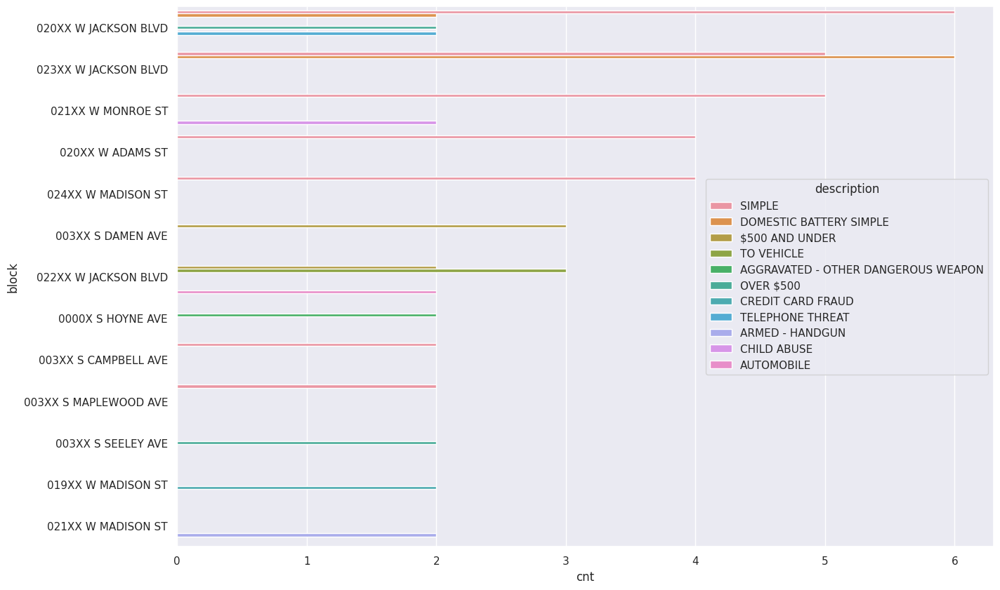


block  by  location_description
                    block                    location_description  cnt
0    020XX W JACKSON BLVD                               APARTMENT   12
1    023XX W JACKSON BLVD                                  STREET    8
2    022XX W JACKSON BLVD                                  STREET    6
3       003XX S DAMEN AVE                               APARTMENT    5
4      019XX W MADISON ST                  SPORTS ARENA / STADIUM    5
5    020XX W JACKSON BLVD                                  STREET    5
6       021XX W MONROE ST                SCHOOL - PUBLIC BUILDING    4
7        022XX W ADAMS ST                                  STREET    4
8    022XX W JACKSON BLVD                               APARTMENT    4
9    023XX W JACKSON BLVD                               APARTMENT    4
10     023XX W MADISON ST  PARKING LOT / GARAGE (NON RESIDENTIAL)    4
11     023XX W MADISON ST                                  STREET    4
12  003XX S MAPLEWOOD AVE                   

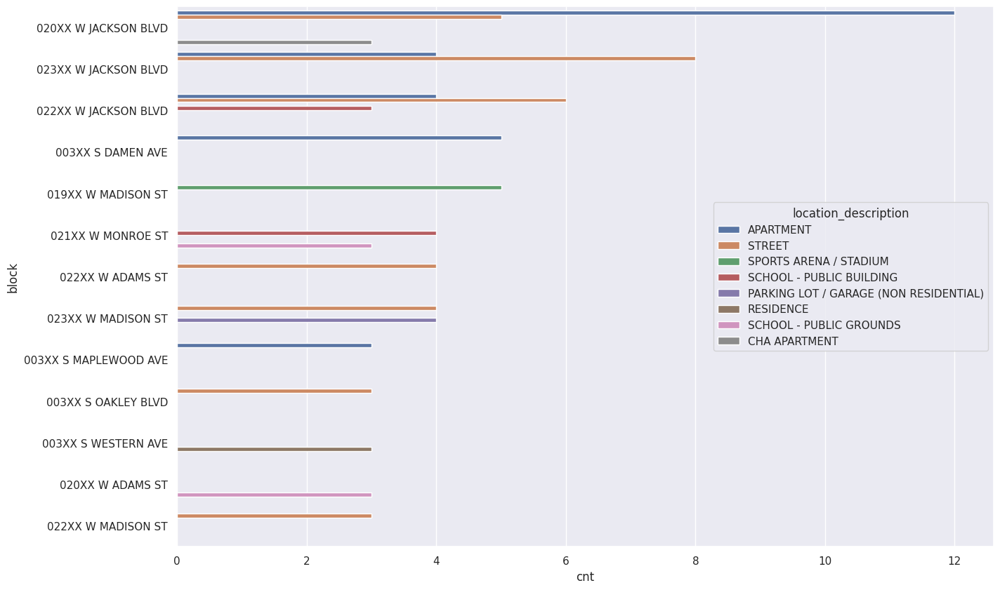


description  by  location_description
                            description      location_description  cnt
0                                SIMPLE                 APARTMENT   15
1                            AUTOMOBILE                    STREET   14
2                            TO VEHICLE                    STREET   14
3                             OVER $500                    STREET    9
4                        $500 AND UNDER                    STREET    8
5               DOMESTIC BATTERY SIMPLE                 APARTMENT    8
6                                SIMPLE                    STREET    7
7                           TO PROPERTY                 APARTMENT    7
8                        $500 AND UNDER                 APARTMENT    6
9               DOMESTIC BATTERY SIMPLE                    STREET    4
10                               SIMPLE  SCHOOL - PUBLIC BUILDING    4
11                               SIMPLE   SCHOOL - PUBLIC GROUNDS    4
12               STRONG ARM - NO WEAPO

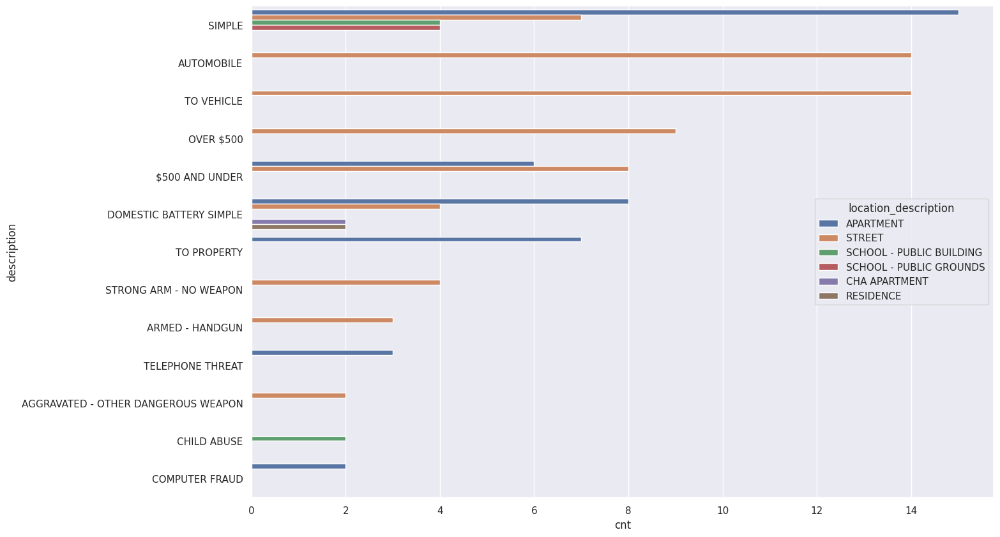

In [ ]:
# Bivariate analysis

topN = 20

f = open("drive/MyDrive/" + Address_Comp + "_BivariateAnalysis.txt", 'w')

#catCols = ['DOW', 'primary_type', 'block', 'description', 'location_description']
catCols =  ['date', 'DOW', 'Hour', 'primary_type', 'block', 'description', 
           'location_description']
numCols = len(catCols)
for i in range(0, numCols-1):
  for j in range(i+1, numCols):
    col1 = catCols[i]
    col2 = catCols[j]
    print("\n" + col1, " by ", col2)
    print("\n" + col1, " by ", col2, file=f)

    tmpDF = countByColsAndCoordinates(col1, col2, Min_Lat, Max_Lat, Min_Lon, Max_Lon, numDays)
    print(tmpDF.head(topN))
    print(tmpDF.head(topN), file=f)

    # Create plot
    plt.figure(figsize = (15, 10))
    sns.barplot(data=tmpDF[:topN], x="cnt", y=col1, hue=col2)
    plt.show()

f.close()

# Comparing crime totals for two locations

In [ ]:
# Creates widgets to enter second address
def on_click2(_):
    address = address_input2.value
    try:
        latitude, longitude = find_address_ccordinates(address)
        latitude_Result2.value = latitude
        longitude_Result2.value = longitude
    except Exception as e:
        print(f"Error: {e}")

address_input2 = widgets.Textarea(
    placeholder="Enter address to locate here....",
    layout=widgets.Layout(width="50%", height="40px")
)
query_button2 = widgets.Button(
    description="Find Coordinates",
    button_style="info"
)
latitude_Result2 = widgets.FloatText(
    value=0.0,
    description='LAT:',
    disabled=False
)
longitude_Result2 = widgets.FloatText(
    value=0.0,
    description='LON:',
    disabled=False
)
numDays_input2 = widgets.IntSlider(
    value=20,
    min=20,
    max=360,
    step=20,
    description='Num. Days:',
    disabled=False,
    continuous_update=False,
    orientation='horizontal',
    readout=True,
    readout_format='d'
)
numBlocks_input2 = widgets.IntSlider(
    value=5,
    min=2,
    max=20,
    step=1,
    description='Num. Blocks:',
    disabled=False,
    continuous_update=False,
    orientation='horizontal',
    readout=True,
    readout_format='d'
)

query_button2.on_click(on_click2)
display(address_input2, numDays_input2, numBlocks_input2, query_button2, latitude_Result2, longitude_Result2)

Textarea(value='', layout=Layout(height='40px', width='50%'), placeholder='Enter address to locate here....')

IntSlider(value=20, continuous_update=False, description='Num. Days:', max=360, min=20, step=20)

IntSlider(value=5, continuous_update=False, description='Num. Blocks:', max=20, min=2)

Button(button_style='info', description='Find Coordinates', style=ButtonStyle())

FloatText(value=0.0, description='LAT:')

FloatText(value=0.0, description='LON:')

In [ ]:
# Parameters to be used for the rest of the analysis
Address2 = address_input2.value
Addr_Lat2 = latitude_Result2.value
Addr_Lon2 = longitude_Result2.value
numDays2 = numDays_input2.value
NumBlocks2 = numBlocks_input2.value
Address_Comp2 = "%s (%0.5f, %0.5f) - %d block radius - Last %d days" % (Address2, Addr_Lat2, Addr_Lon2, NumBlocks2, numDays2)
print(Address_Comp2)

1400 S. Hasted Chicago IL (41.86342, -87.64681) - 5 block radius - Last 40 days


In [ ]:
# Calculate coordinates of area to explore
Min_Lat2 = Addr_Lat2 - (NumBlocks2 * Lat_Radius)
Max_Lat2 = Addr_Lat2 + (NumBlocks2 * Lat_Radius)

Min_Lon2 = Addr_Lon2 - (NumBlocks2 * Lon_Radius)
Max_Lon2 = Addr_Lon2 + (NumBlocks2 * Lon_Radius)

In [ ]:
# Filter original dataset to include crimes in the rectangle defined
newDF2 = resultsInsideCoordinates(Min_Lat2, Max_Lat2, Min_Lon2, Max_Lon2, numDays2)
newDF2.shape

(100, 21)

/usr/local/lib/python3.10/dist-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
/usr/local/lib/python3.10/dist-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


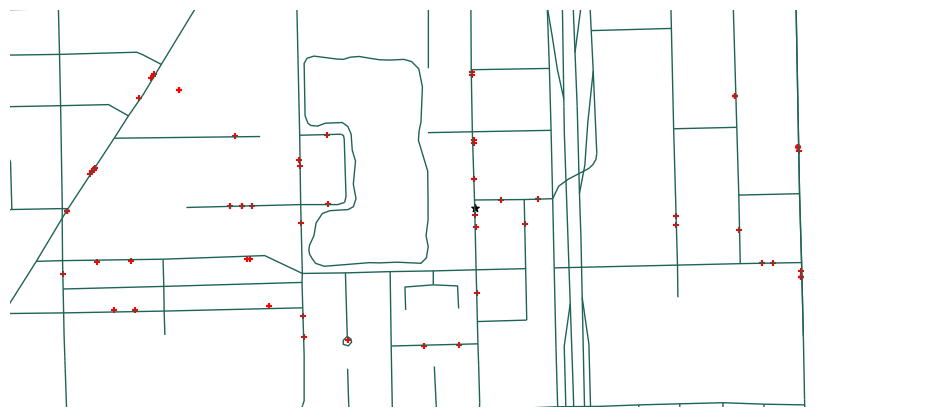

In [ ]:
# Generate streetmap highlighting crime points
# Create a new dataframe with crime coordinates
tempDF = pd.DataFrame()
tempDF['latitude'] = newDF2['latitude']
tempDF['longitude'] = newDF2['longitude']
pointsDF = createGeoDataFrame(tempDF)
# Create second dataframe with address coordinates
tempDF2 = pd.DataFrame([[Addr_Lat2, Addr_Lon2]], columns=['latitude', 'longitude'])
mainPointDF = createGeoDataFrame(tempDF2)

showMapAreaAndPoints(map_df, Min_Lat2, Max_Lat2, Min_Lon2, Max_Lon2, pointsDF, mainPointDF)

In [ ]:
########### Work in Progress .....
allCols = ['date', 'primary_type', 'description', 'location_description', 'DOW', 'Hour']

for col1 in ['primary_type']:
  for col2 in allCols:
    if col2 != col1:
      # First location
      df1 = countByColsAndCoordinates(col1, col2, Min_Lat, Max_Lat, Min_Lon, Max_Lon, numDays)
      # Second location
      df2 = countByColsAndCoordinates(col1, col2, Min_Lat2, Max_Lat2, Min_Lon2, Max_Lon2, numDays2)

      # Combining two results dataframes. The _merge column indicates whether the info came from the 
      # left or right dataframe.
      # The Diff column has the count difference for the records found on both dataframes.
      dfMerge = df1.merge(df2, on=[col1, col2,], suffixes=['_df1','_df2'], how='outer', indicator=True).eval('Diff=cnt_df1 - cnt_df2')

      print ("\nComparing:\n[A1]", Address_Comp, "\n[A2]", Address_Comp2)

      dfMerge['cnt_df1'] = dfMerge['cnt_df1'].fillna(0)
      dfMerge['cnt_df2'] = dfMerge['cnt_df2'].fillna(0)
      dfMerge['Diff'] = dfMerge['Diff'].fillna(0)

      for i in range(len(dfMerge)):
        resultTxt = ""
        if dfMerge['_merge'][i] == 'both': # same item shows in both dataframes
          if dfMerge['Diff'][i] > 0:
            result = dfMerge['Diff'][i] / dfMerge['cnt_df2'][i] * 100
            resultTxt = "Address 1 has %3d (%6.2f%%) more" % (dfMerge['Diff'][i], result)
          elif dfMerge['Diff'][i] < 0:
            result = dfMerge['Diff'][i] / dfMerge['cnt_df1'][i] * 100
            resultTxt = "Address 2 has %3d (%6.2f%%) more" % (dfMerge['Diff'][i]*(-1), result*(-1))
          else:
            resultTxt = "SAME"
        elif dfMerge['_merge'][i] == 'left_only':
          resultTxt = "Address 1 ONLY"
        else:
          resultTxt = "Address 2 ONLY"
        print("%s: %-30s, %s: %-30s  A1: %3d    A2: %3d  %s" % (col1, dfMerge[col1][i],
                                                    col2, dfMerge[col2][i],
                                                    dfMerge['cnt_df1'][i],
                                                    dfMerge['cnt_df2'][i],
                                                    resultTxt))


Comparing:
[A1] 150 S, Bell St Chicago IL (41.87891, -87.68277) - 5 block radius - Last 40 days 
[A2] 1400 S. Hasted Chicago IL (41.86342, -87.64681) - 5 block radius - Last 40 days
primary_type: THEFT                         , date: 2023-04-13 00:00:00             A1:   4    A2:   1  Address 1 has   3 (300.00%) more
primary_type: BATTERY                       , date: 2023-03-12 00:00:00             A1:   3    A2:   0  Address 1 ONLY
primary_type: BATTERY                       , date: 2023-04-10 00:00:00             A1:   3    A2:   3  SAME
primary_type: CRIMINAL DAMAGE               , date: 2023-02-27 00:00:00             A1:   3    A2:   0  Address 1 ONLY
primary_type: THEFT                         , date: 2023-03-28 00:00:00             A1:   3    A2:   0  Address 1 ONLY
primary_type: THEFT                         , date: 2023-04-01 00:00:00             A1:   3    A2:   0  Address 1 ONLY
primary_type: ASSAULT                       , date: 2023-02-28 00:00:00             A1:   2    

What to do next:


- Try to correlate crime data with Landmarks/Points of Interest

- Create a Time Series (daily or hourly) dataset to try to predict a type of crime in a particular area of the city.
- Other?